# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [14]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(),y.float()),1)
    #### END CODE HERE ####
    return combined

In [15]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [16]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [17]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [20]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim+n_classes
    discriminator_im_chan = mnist_shape[0]+n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [21]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [22]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.0775810525417326, discriminator loss: 0.29400112710893156


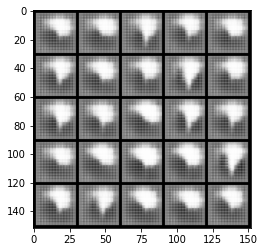

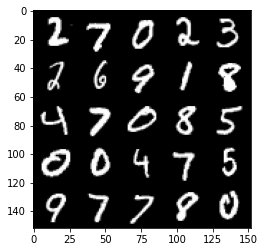

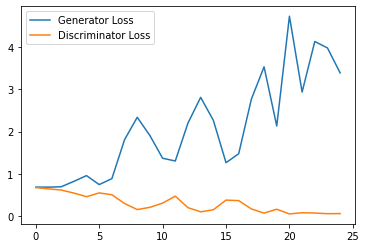

Step 1000: Generator loss: 3.6954309179782867, discriminator loss: 0.09152422175370156


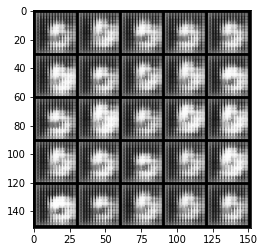

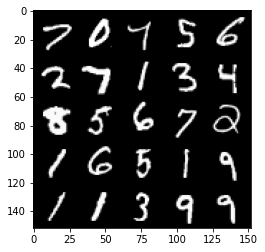

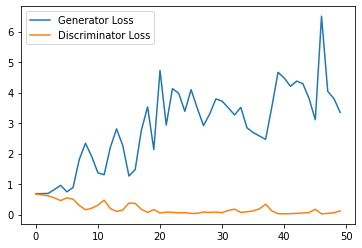

Step 1500: Generator loss: 3.8211680653095246, discriminator loss: 0.07517045593820512


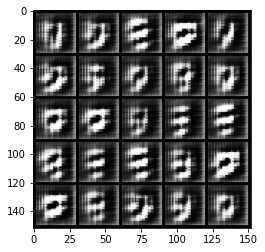

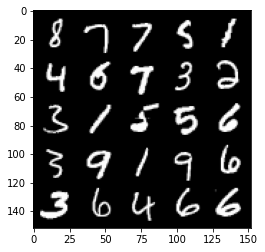

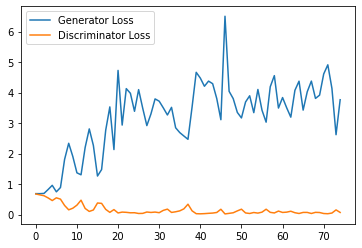

Step 2000: Generator loss: 3.4731933584213257, discriminator loss: 0.13297041378915309


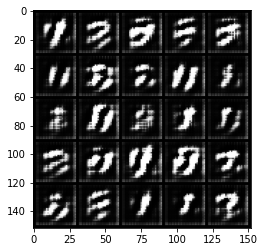

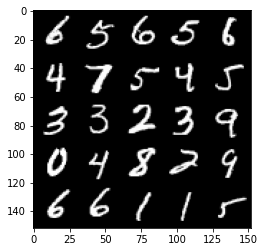

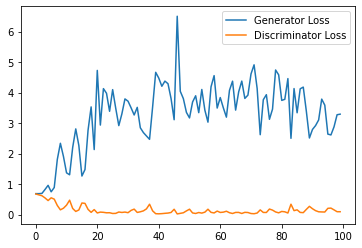

Step 2500: Generator loss: 3.040309530735016, discriminator loss: 0.168537365347147


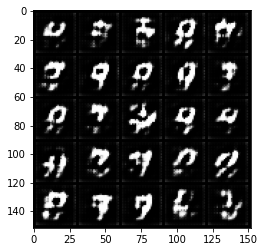

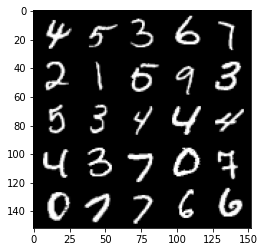

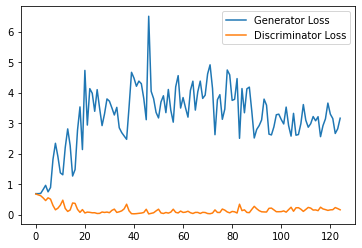

Step 3000: Generator loss: 2.2843051767349243, discriminator loss: 0.2944074161052704


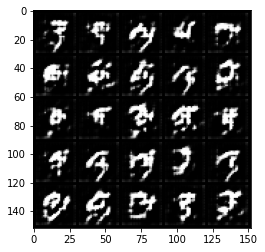

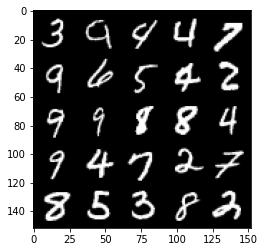

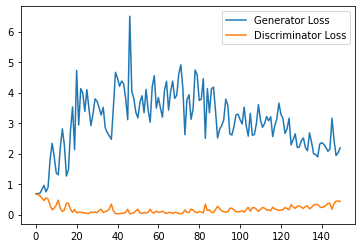

Step 3500: Generator loss: 2.0950569684505465, discriminator loss: 0.34635104128718375


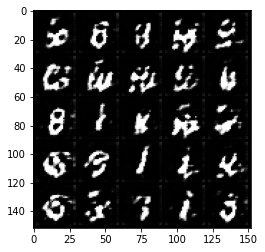

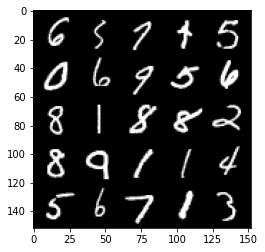

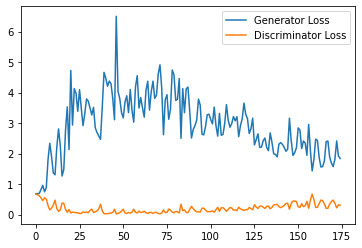

Step 4000: Generator loss: 1.9361679282188415, discriminator loss: 0.34646990489959717


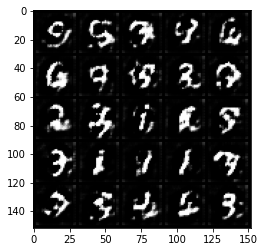

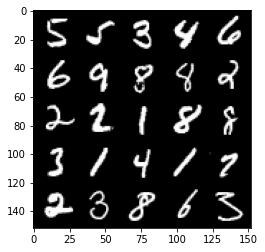

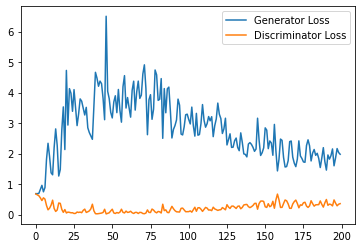

Step 4500: Generator loss: 1.9082729098796845, discriminator loss: 0.35502718275785444


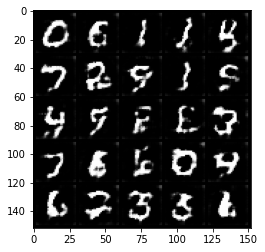

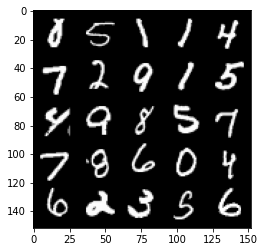

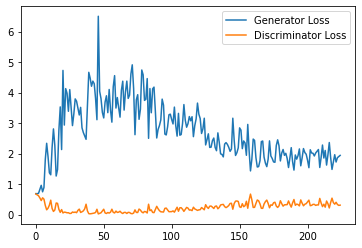

Step 5000: Generator loss: 1.8238746376037598, discriminator loss: 0.3582952356040478


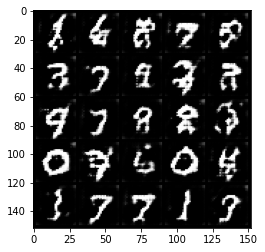

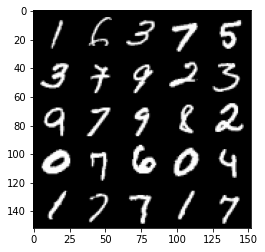

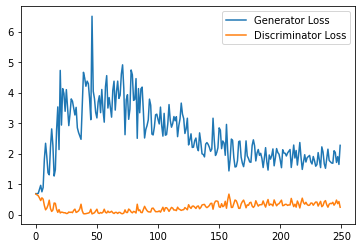

Step 5500: Generator loss: 1.8234250288009644, discriminator loss: 0.3778295328319073


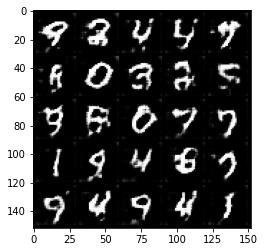

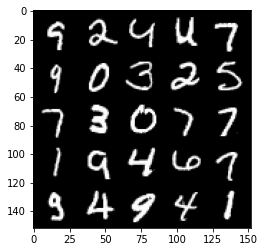

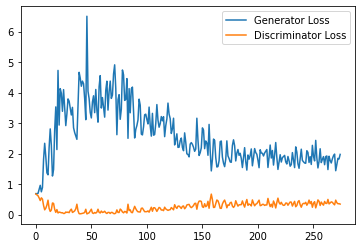

Step 6000: Generator loss: 1.5960770807266236, discriminator loss: 0.40806079787015914


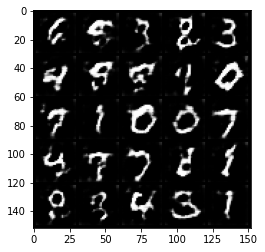

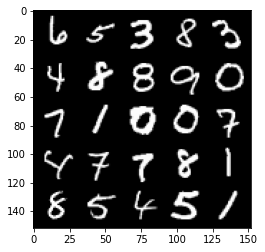

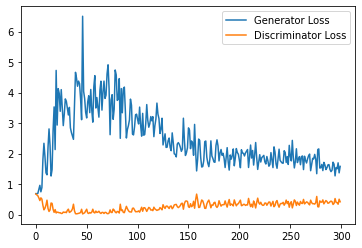

Step 6500: Generator loss: 1.581306305885315, discriminator loss: 0.43267731550335886


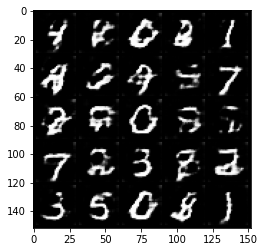

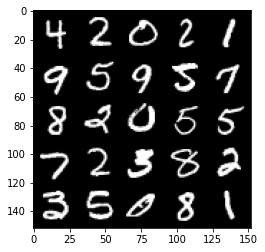

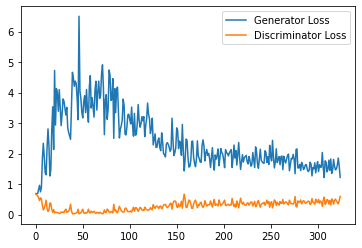

Step 7000: Generator loss: 1.461462417960167, discriminator loss: 0.45654867696762086


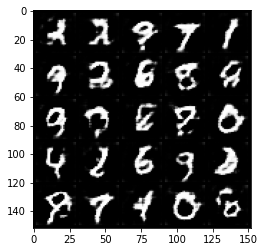

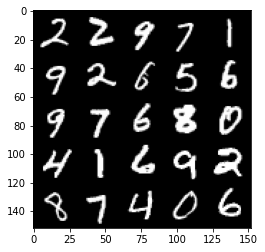

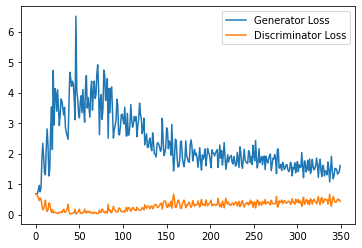

Step 7500: Generator loss: 1.5966399735212327, discriminator loss: 0.49002662831544874


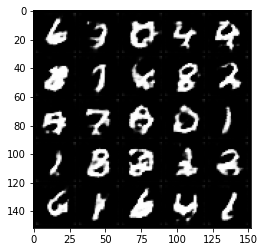

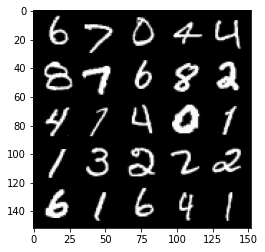

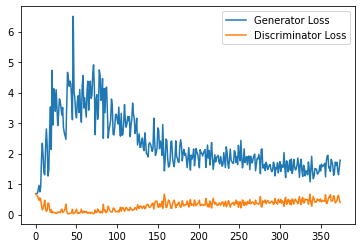

Step 8000: Generator loss: 1.3440707691907883, discriminator loss: 0.49940433222055436


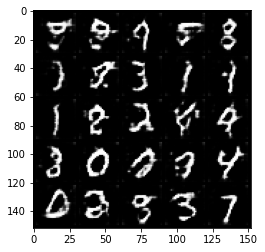

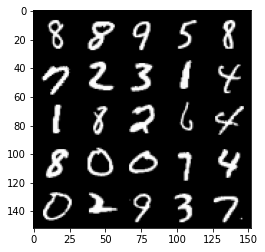

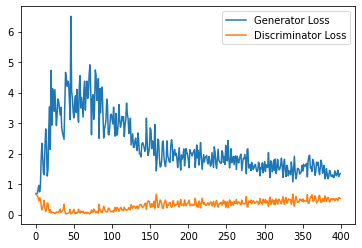

Step 8500: Generator loss: 1.3554238382577897, discriminator loss: 0.51987464594841


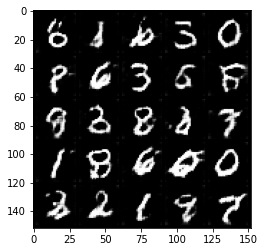

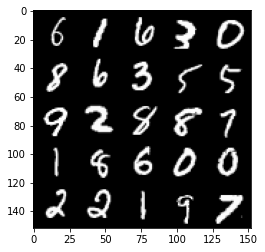

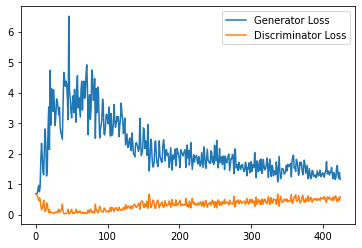

Step 9000: Generator loss: 1.265948862195015, discriminator loss: 0.5342691045999527


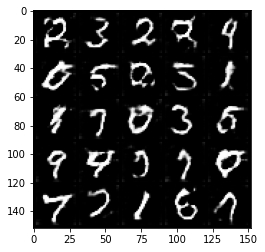

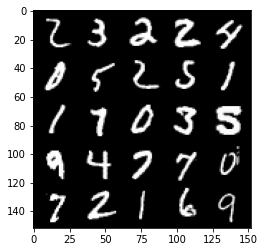

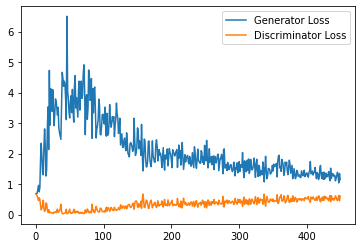

Step 9500: Generator loss: 1.226264301300049, discriminator loss: 0.5447259417176247


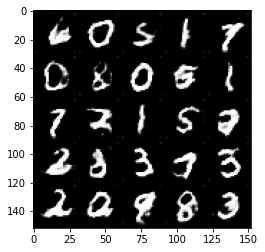

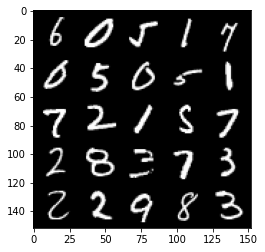

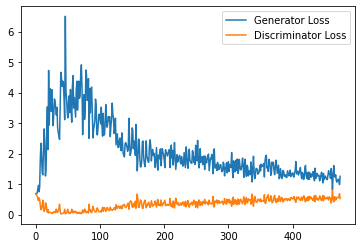

Step 10000: Generator loss: 1.1826479519605637, discriminator loss: 0.5370127249360085


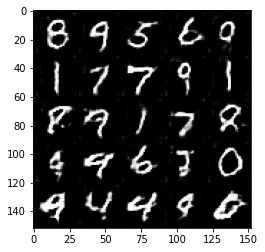

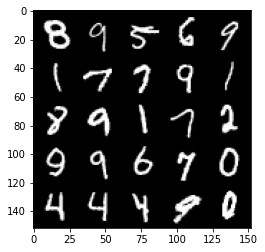

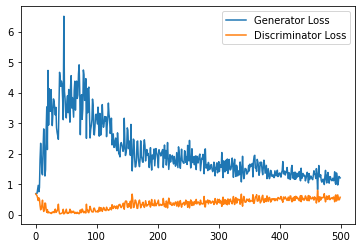

Step 10500: Generator loss: 1.1714754024744034, discriminator loss: 0.559588707625866


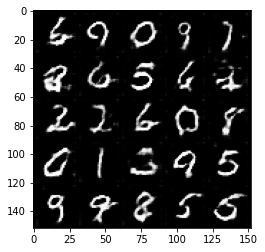

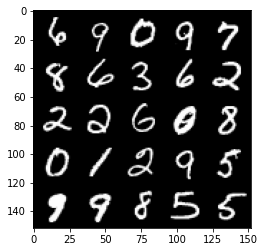

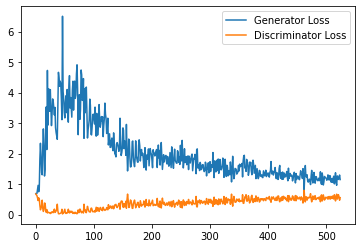

Step 11000: Generator loss: 1.1847753518819808, discriminator loss: 0.5648951694965363


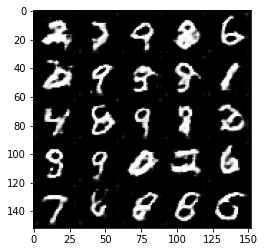

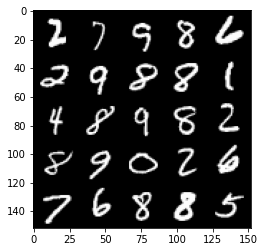

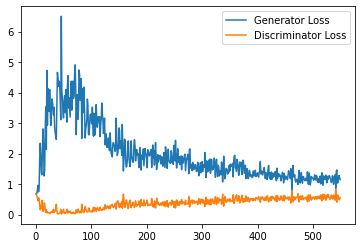

Step 11500: Generator loss: 1.1034678065776824, discriminator loss: 0.5734106369614601


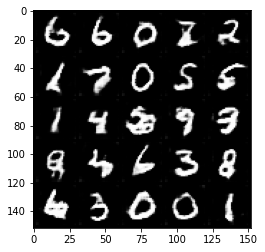

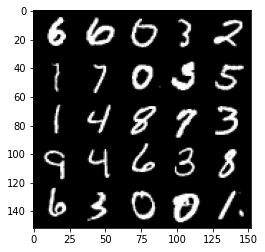

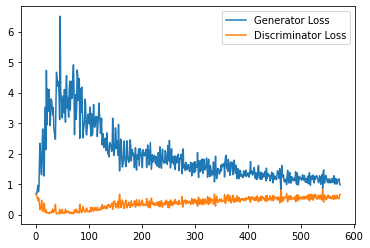

Step 12000: Generator loss: 1.1224399899244308, discriminator loss: 0.5713717401027679


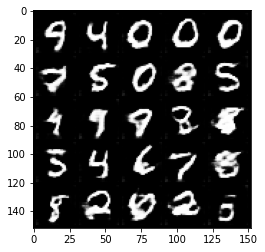

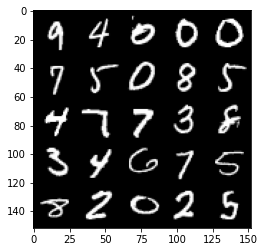

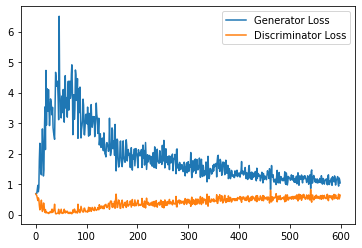

Step 12500: Generator loss: 1.1471292613744735, discriminator loss: 0.5730818548798561


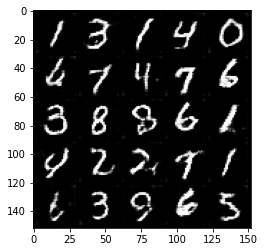

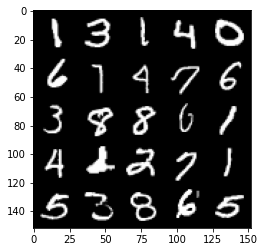

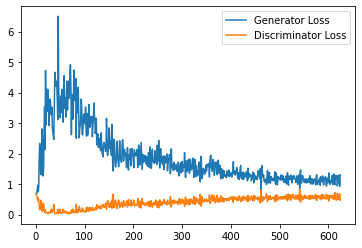

Step 13000: Generator loss: 1.114856835603714, discriminator loss: 0.5778347292542457


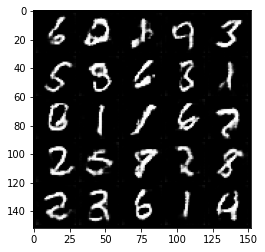

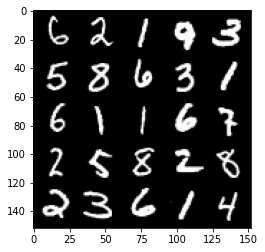

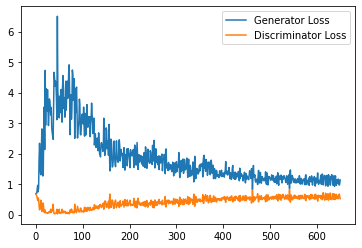

Step 13500: Generator loss: 1.0557610146999359, discriminator loss: 0.5803477593660354


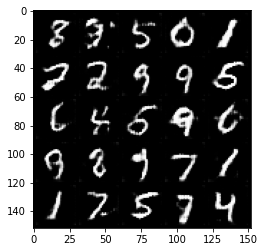

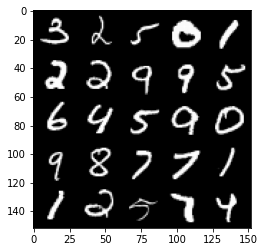

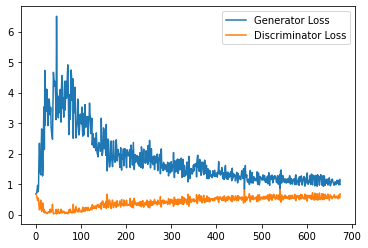

Step 14000: Generator loss: 1.1284611892700196, discriminator loss: 0.5784495481848717


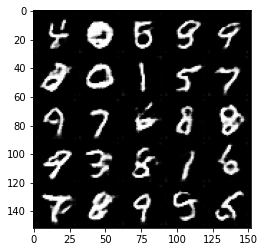

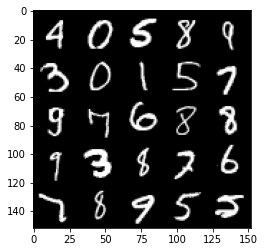

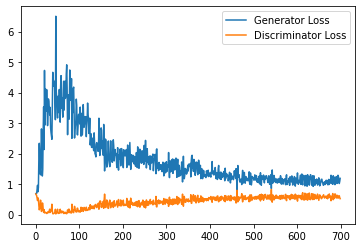

Step 14500: Generator loss: 1.0991101644039154, discriminator loss: 0.5649530178308487


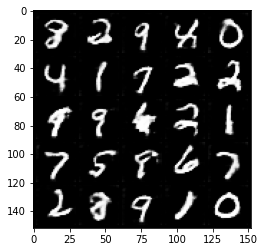

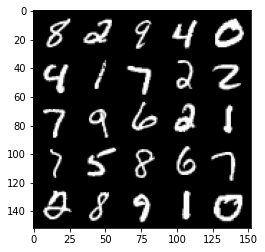

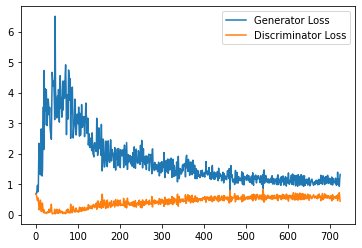

Step 15000: Generator loss: 1.1236734668016433, discriminator loss: 0.5665685404539108


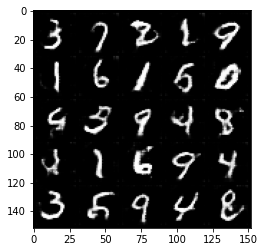

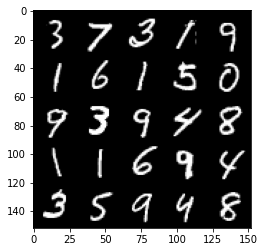

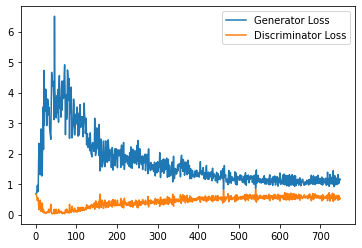

Step 15500: Generator loss: 1.0964598146677018, discriminator loss: 0.5683365115523338


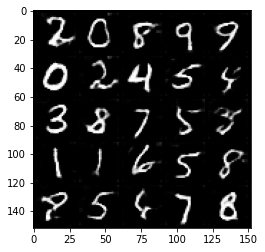

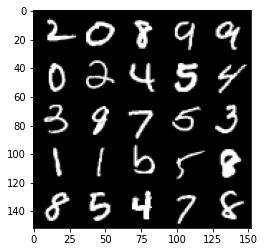

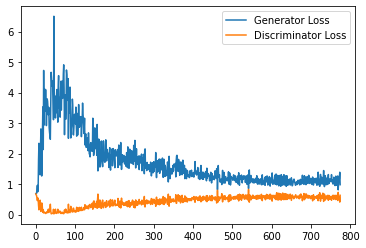

Step 16000: Generator loss: 1.0898352624177934, discriminator loss: 0.5782629741430283


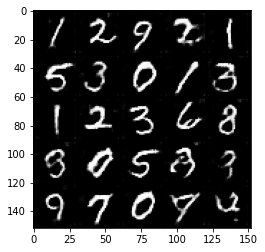

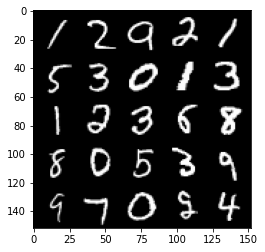

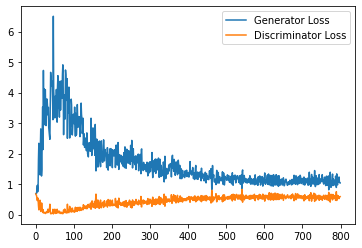

Step 16500: Generator loss: 1.080636902332306, discriminator loss: 0.5753492287993431


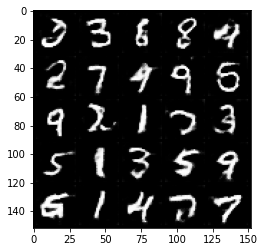

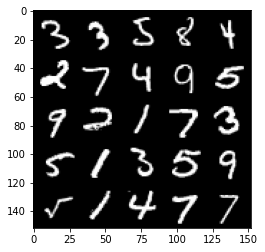

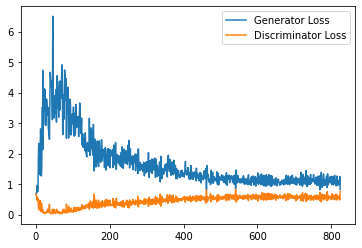

Step 17000: Generator loss: 1.0668021432161332, discriminator loss: 0.5752224169373512


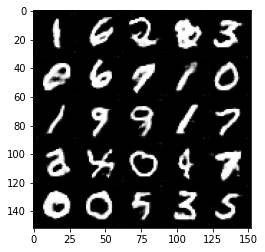

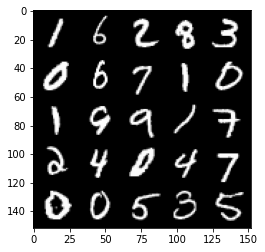

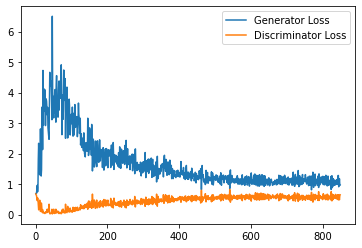

Step 17500: Generator loss: 1.062614640235901, discriminator loss: 0.5763715172410011


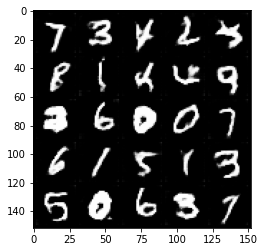

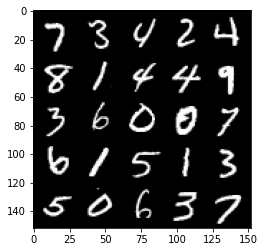

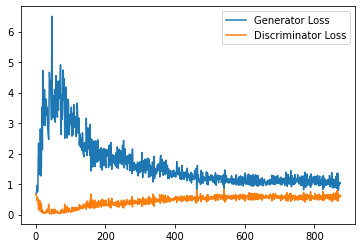

Step 18000: Generator loss: 1.030239089369774, discriminator loss: 0.5852960067391395


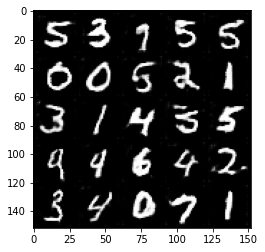

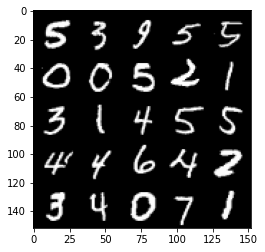

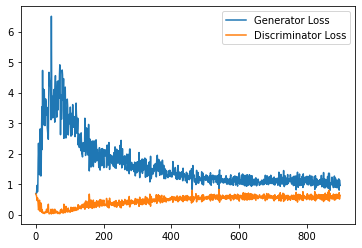

Step 18500: Generator loss: 1.0425549495220183, discriminator loss: 0.581394945859909


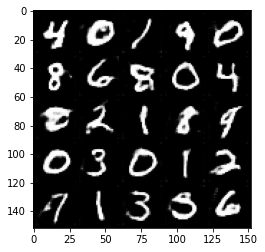

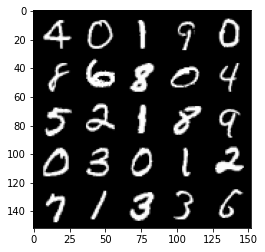

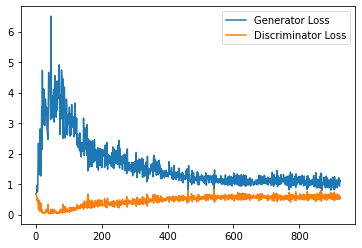

Step 19000: Generator loss: 1.0528098739385605, discriminator loss: 0.5815630552768707


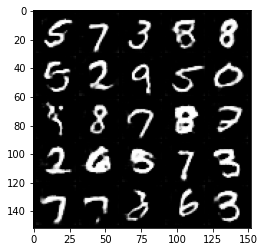

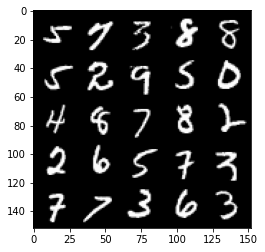

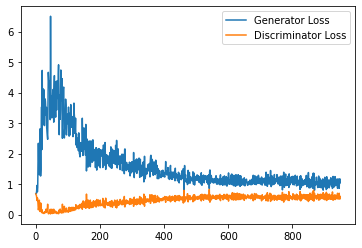

Step 19500: Generator loss: 1.0403212275505065, discriminator loss: 0.5883920364379883


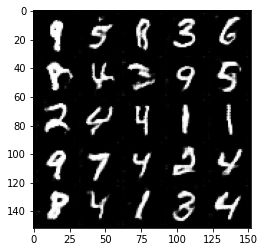

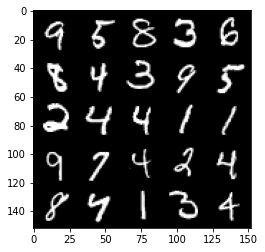

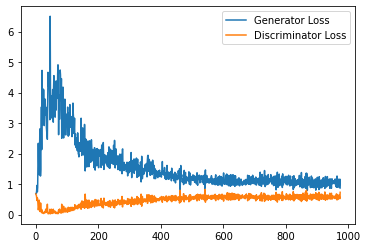

Step 20000: Generator loss: 1.0407302325963974, discriminator loss: 0.5854313607811927


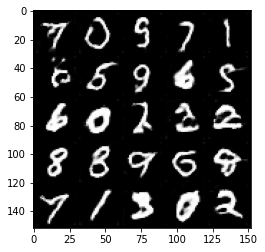

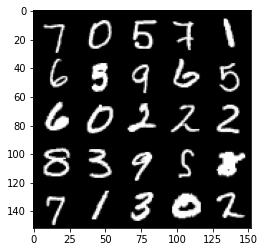

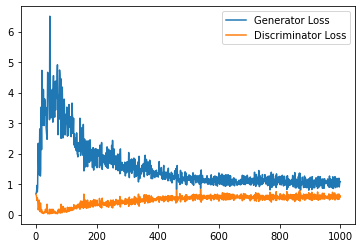

Step 20500: Generator loss: 1.0249569474458695, discriminator loss: 0.5894410403966903


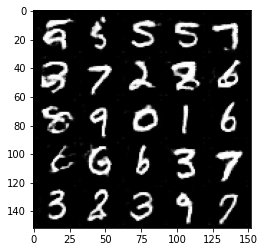

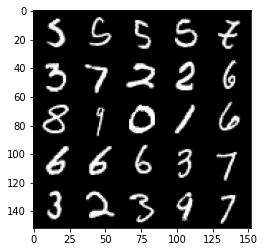

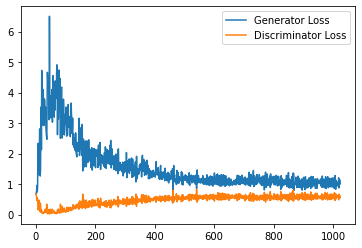

Step 21000: Generator loss: 1.0037701013088227, discriminator loss: 0.5911364609599113


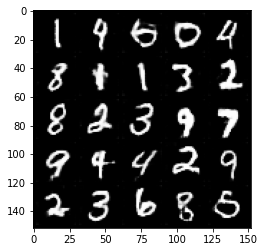

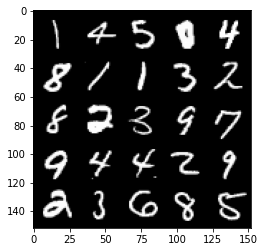

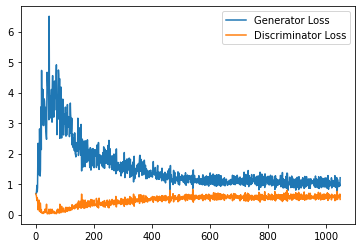

Step 21500: Generator loss: 1.025469403743744, discriminator loss: 0.5911158480644226


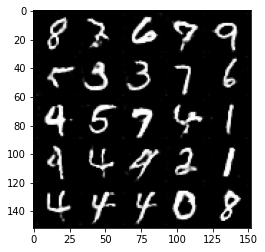

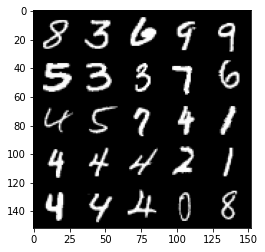

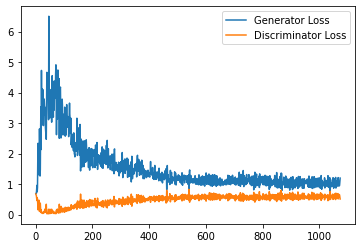

Step 22000: Generator loss: 1.0224438437223435, discriminator loss: 0.5980945683717728


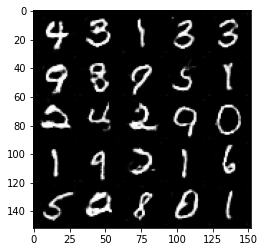

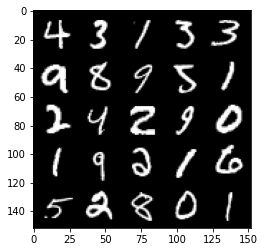

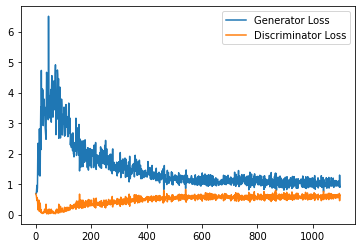

Step 22500: Generator loss: 1.0099916115999221, discriminator loss: 0.5850764582157135


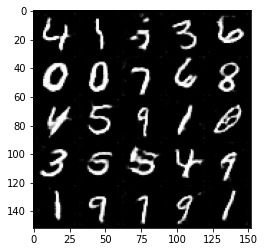

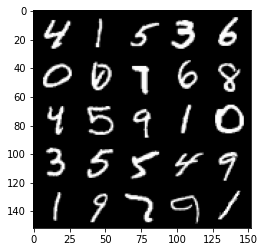

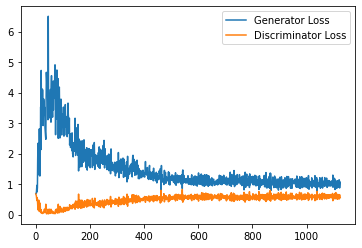

Step 23000: Generator loss: 1.001517923116684, discriminator loss: 0.5889272568225861


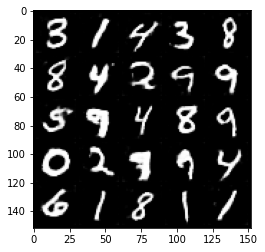

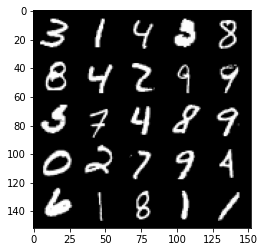

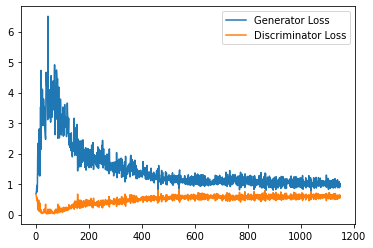

Step 23500: Generator loss: 1.0025863437652587, discriminator loss: 0.5882514872550965


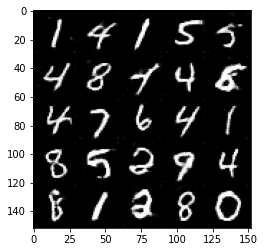

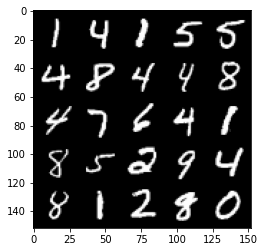

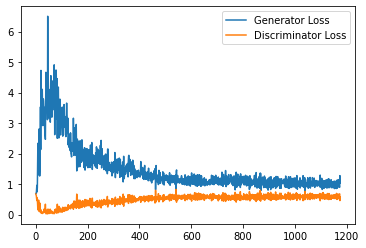

Step 24000: Generator loss: 1.0080684002637863, discriminator loss: 0.5946141564846039


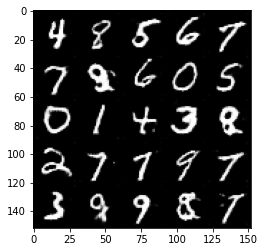

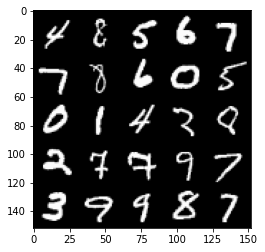

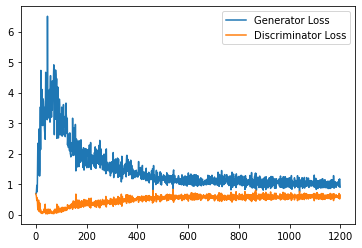

Step 24500: Generator loss: 1.0240707955360413, discriminator loss: 0.595226147711277


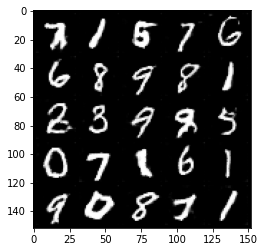

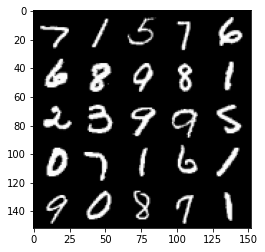

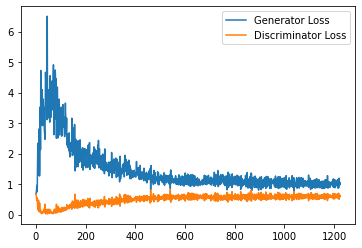

Step 25000: Generator loss: 1.013760267853737, discriminator loss: 0.5913362572193146


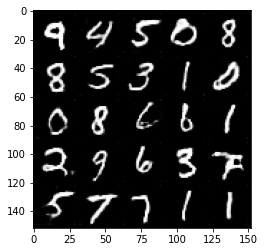

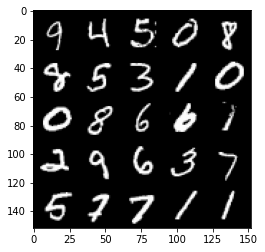

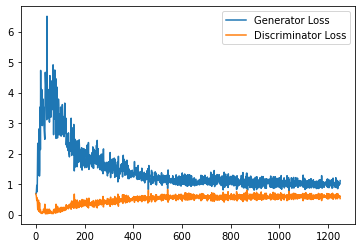

Step 25500: Generator loss: 0.9958587807416915, discriminator loss: 0.5978136820793152


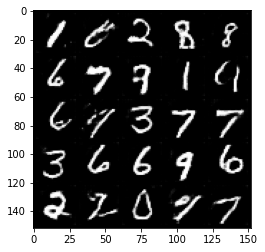

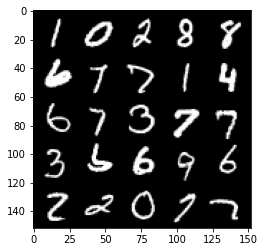

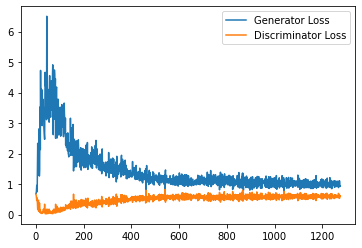

Step 26000: Generator loss: 0.9915759720802307, discriminator loss: 0.5967382979989052


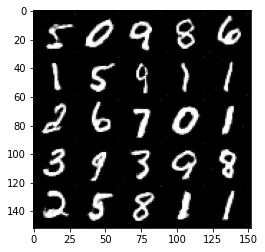

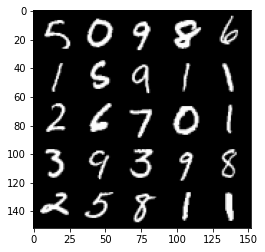

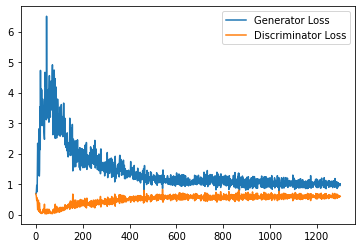

Step 26500: Generator loss: 0.9988277667760849, discriminator loss: 0.5988092075586319


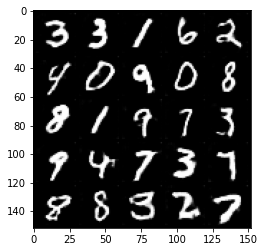

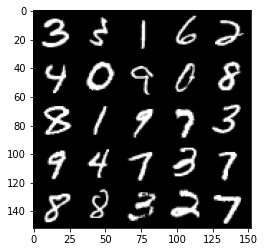

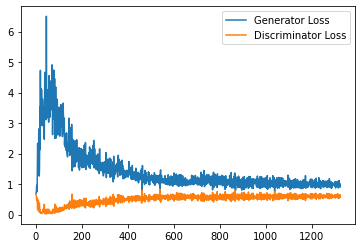

Step 27000: Generator loss: 0.9851338521242142, discriminator loss: 0.594948798418045


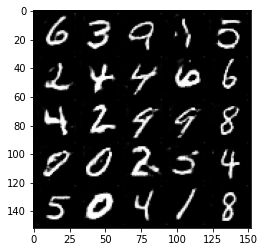

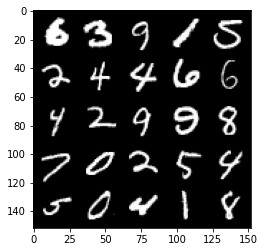

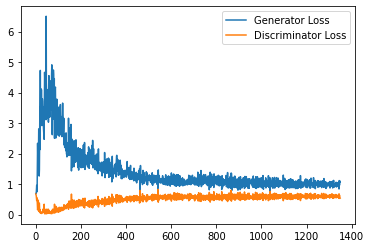

Step 27500: Generator loss: 0.977981657743454, discriminator loss: 0.6044940769076347


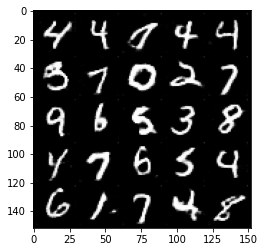

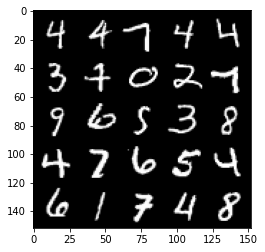

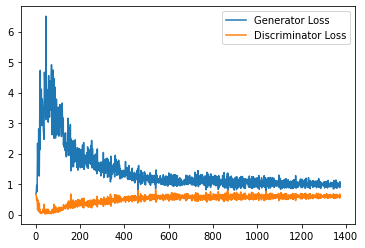

Step 28000: Generator loss: 0.9875038423538208, discriminator loss: 0.6036843265891075


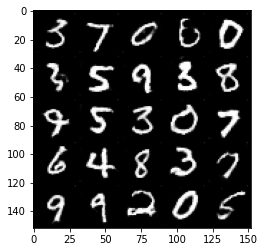

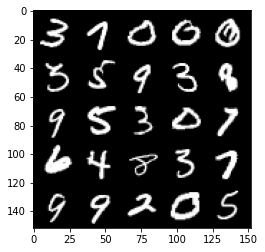

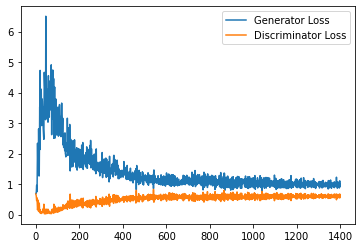

Step 28500: Generator loss: 0.981083202958107, discriminator loss: 0.6040811057686806


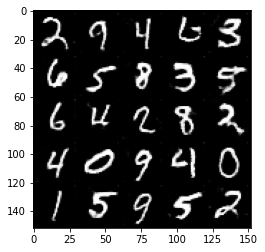

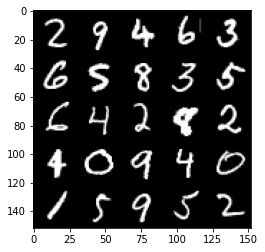

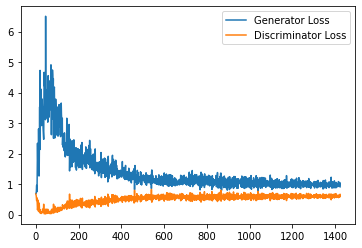

Step 29000: Generator loss: 0.9905936876535416, discriminator loss: 0.6075564299821854


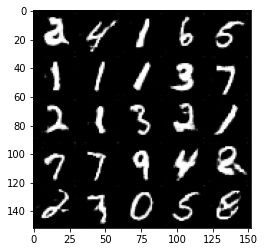

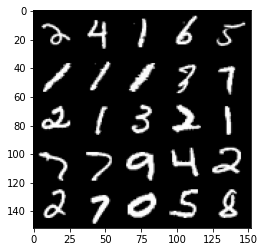

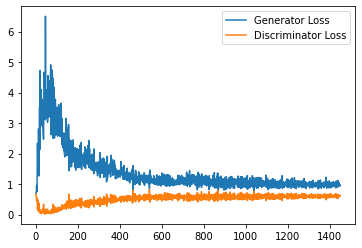

Step 29500: Generator loss: 0.9833326200246811, discriminator loss: 0.6109164346456528


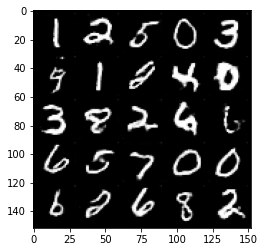

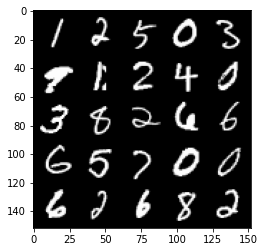

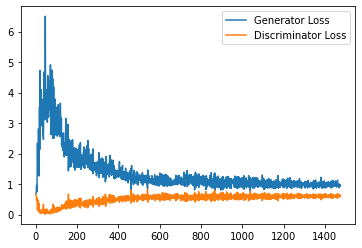

Step 30000: Generator loss: 0.9652740947008133, discriminator loss: 0.6097982415556907


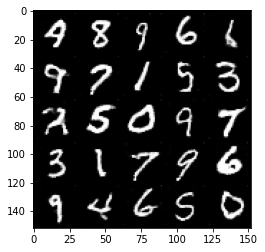

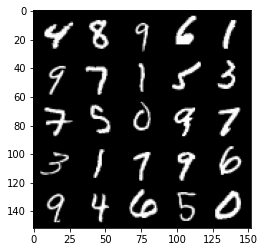

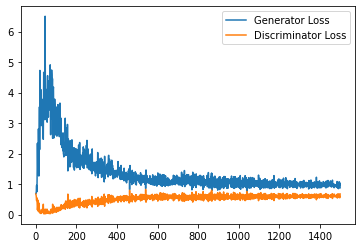

Step 30500: Generator loss: 0.96356185901165, discriminator loss: 0.6044440977573394


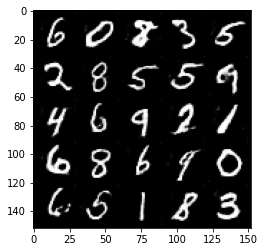

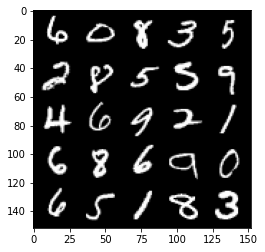

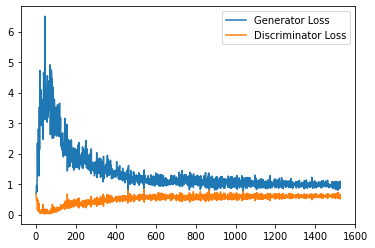

Step 31000: Generator loss: 0.9620311864614487, discriminator loss: 0.6100112398266793


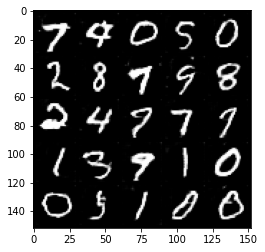

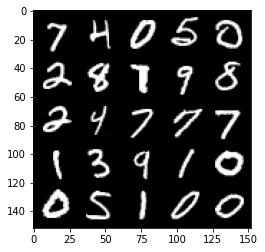

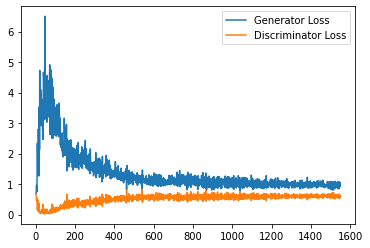

Step 31500: Generator loss: 0.9690772638320923, discriminator loss: 0.6111776962280273


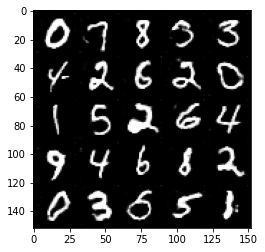

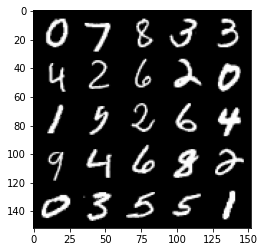

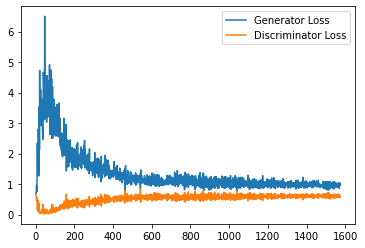

Step 32000: Generator loss: 0.9796885116100311, discriminator loss: 0.6146582404375076


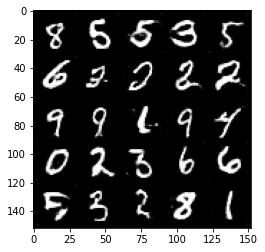

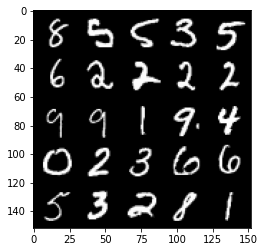

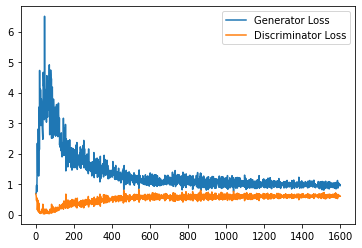

Step 32500: Generator loss: 0.9595703941583633, discriminator loss: 0.613075060248375


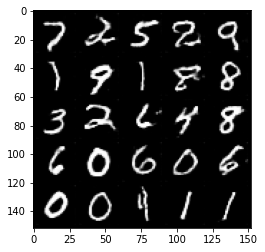

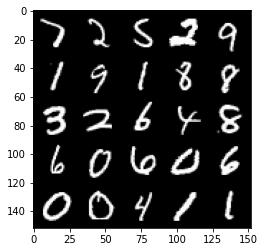

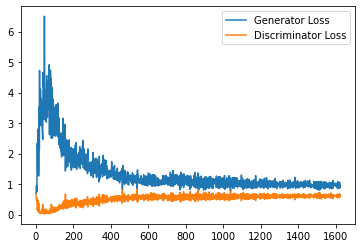

Step 33000: Generator loss: 0.9682035682201385, discriminator loss: 0.6112802346944809


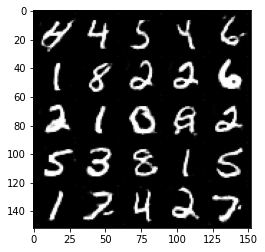

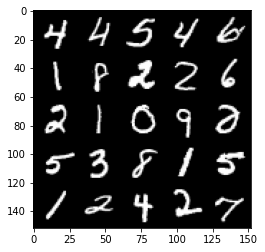

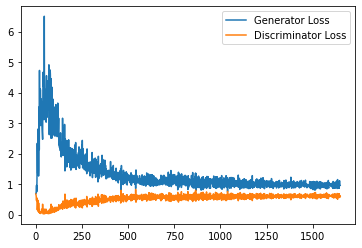

Step 33500: Generator loss: 0.9493174190521241, discriminator loss: 0.615826049387455


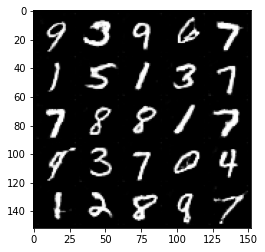

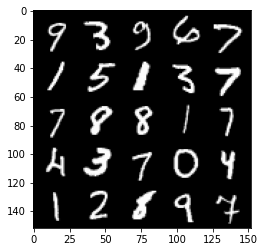

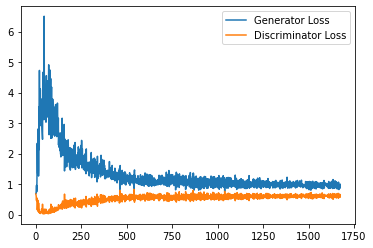

Step 34000: Generator loss: 0.9365478981733322, discriminator loss: 0.6166187278032302


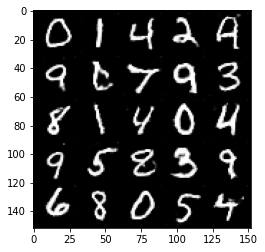

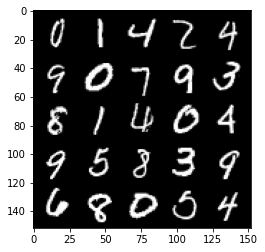

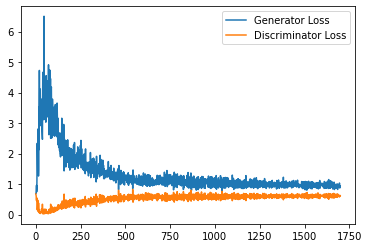

Step 34500: Generator loss: 0.958192162513733, discriminator loss: 0.616580631673336


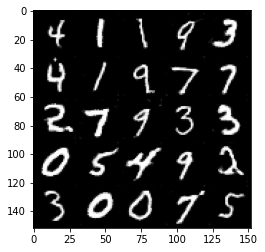

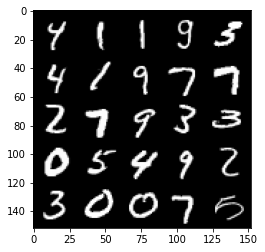

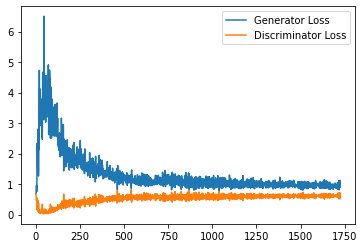

Step 35000: Generator loss: 0.9497260556221009, discriminator loss: 0.6174987935423851


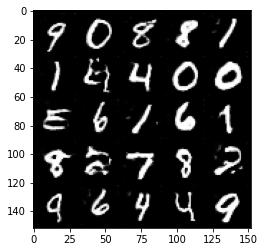

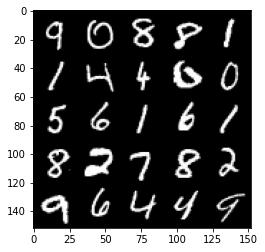

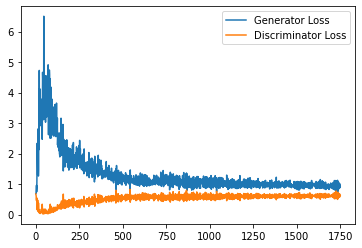

Step 35500: Generator loss: 0.9496497391462326, discriminator loss: 0.6178290175199509


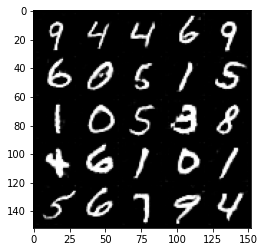

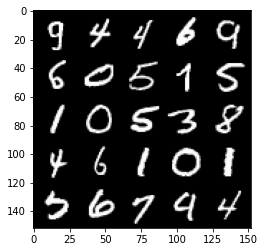

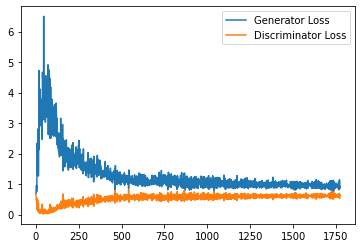

Step 36000: Generator loss: 0.9494672372341156, discriminator loss: 0.6199136815071106


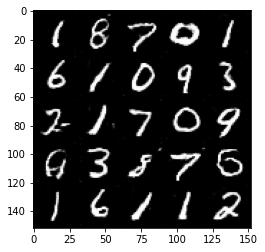

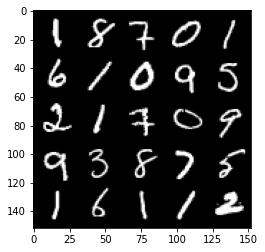

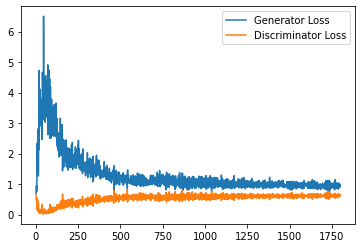

Step 36500: Generator loss: 0.9635183936357499, discriminator loss: 0.6167355017066002


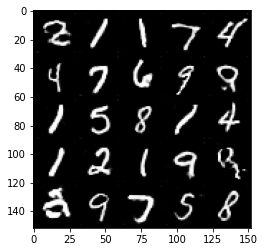

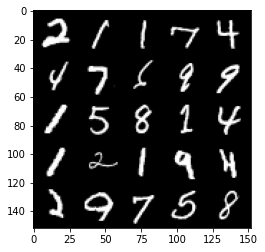

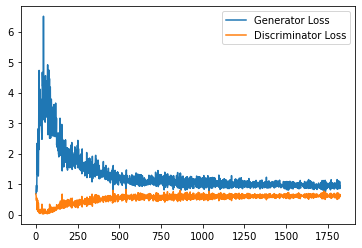

Step 37000: Generator loss: 0.9202859411239624, discriminator loss: 0.6232647899985313


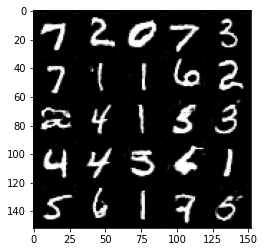

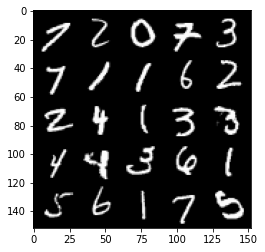

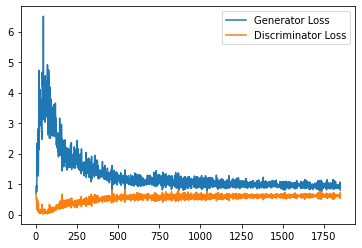

Step 37500: Generator loss: 0.9645416538715362, discriminator loss: 0.6152173353433609


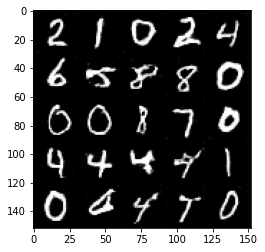

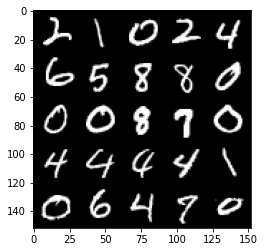

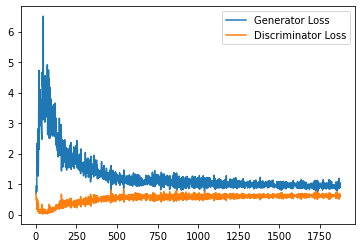

Step 38000: Generator loss: 0.9391030827760697, discriminator loss: 0.6182120072841645


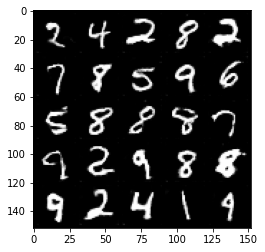

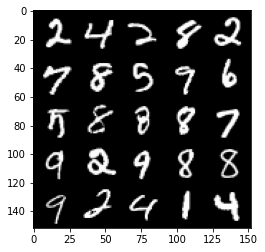

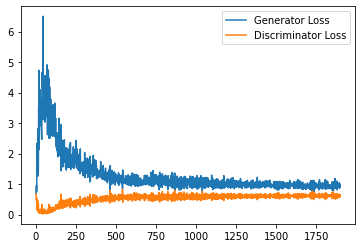

Step 38500: Generator loss: 0.9326114134788513, discriminator loss: 0.6222337532639504


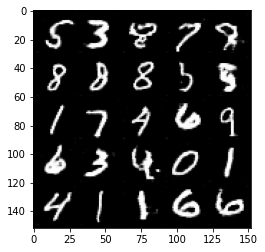

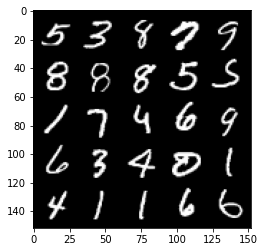

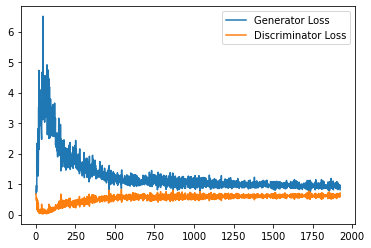

Step 39000: Generator loss: 0.942676032781601, discriminator loss: 0.6161522241830826


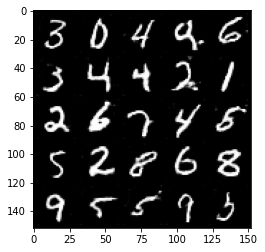

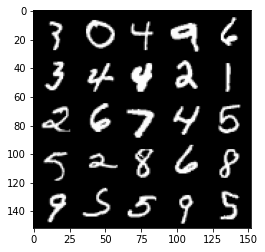

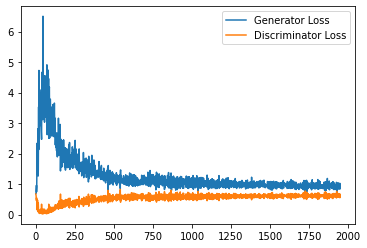

Step 39500: Generator loss: 0.9415308804512024, discriminator loss: 0.6232473270297051


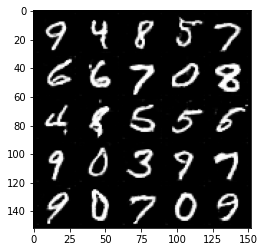

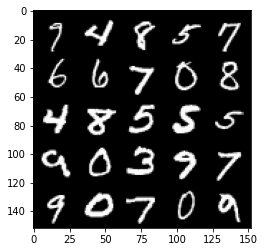

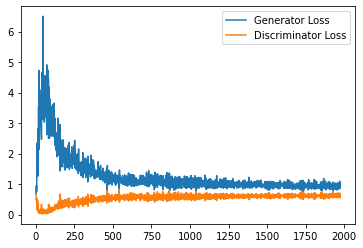

Step 40000: Generator loss: 0.9508546849489212, discriminator loss: 0.6220608952045441


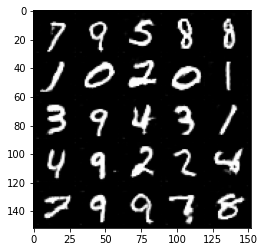

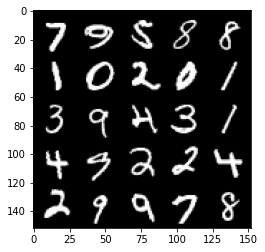

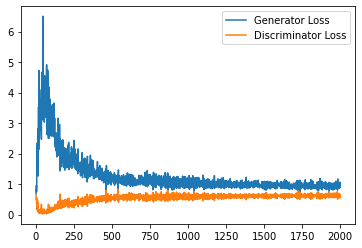

Step 40500: Generator loss: 0.9310880625247955, discriminator loss: 0.6259476035833359


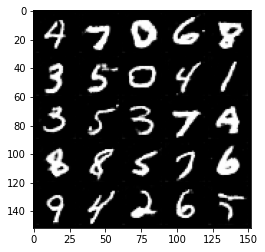

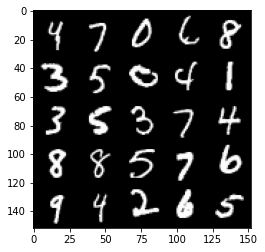

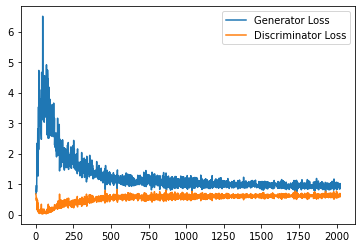

Step 41000: Generator loss: 0.9572768958806992, discriminator loss: 0.6193018535971642


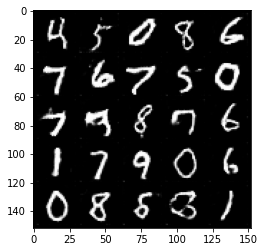

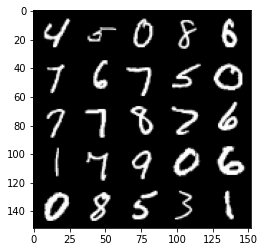

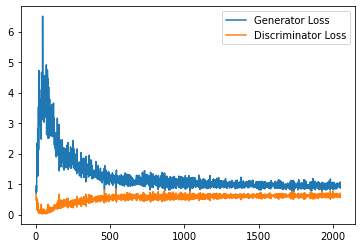

Step 41500: Generator loss: 0.9464017695188522, discriminator loss: 0.6233695637583733


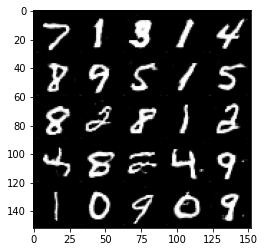

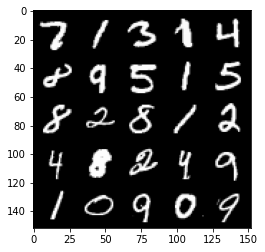

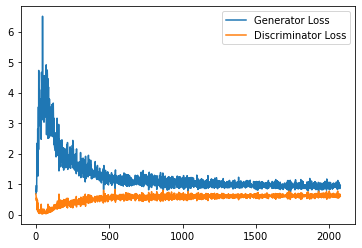

Step 42000: Generator loss: 0.9200500770807266, discriminator loss: 0.622419623374939


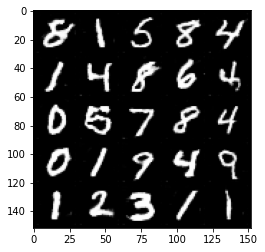

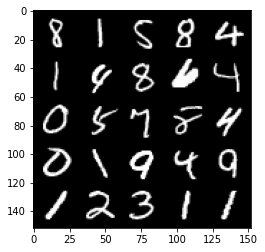

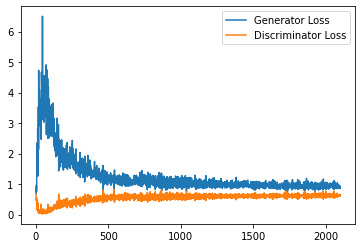

Step 42500: Generator loss: 0.911116291642189, discriminator loss: 0.6230373156070709


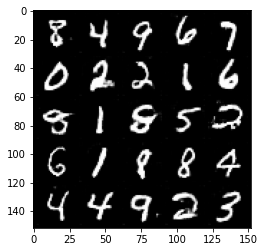

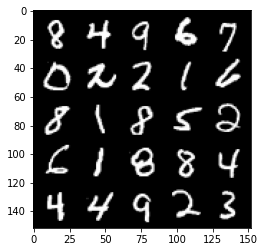

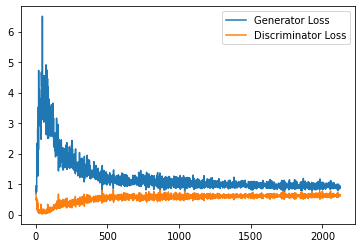

Step 43000: Generator loss: 0.9340233442783356, discriminator loss: 0.6280403376221657


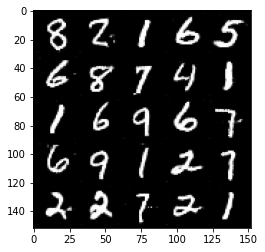

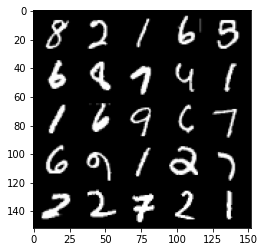

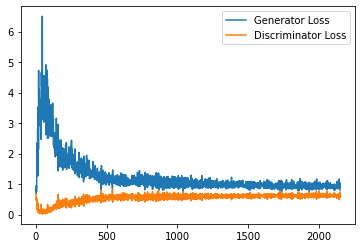

Step 43500: Generator loss: 0.9520447484254837, discriminator loss: 0.6194973165988922


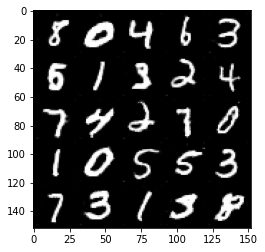

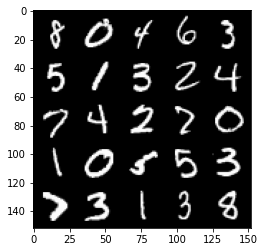

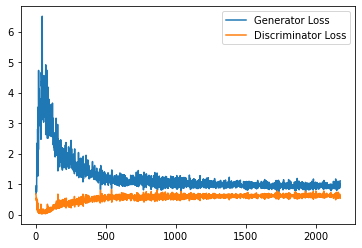

Step 44000: Generator loss: 0.9237627122402191, discriminator loss: 0.624797773361206


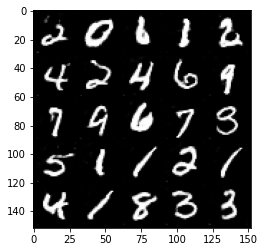

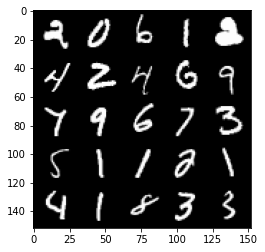

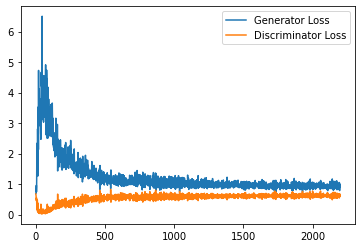

Step 44500: Generator loss: 0.9137519598007202, discriminator loss: 0.6271472225189209


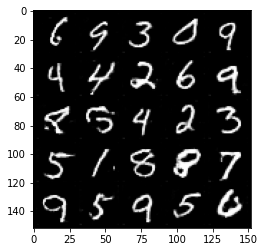

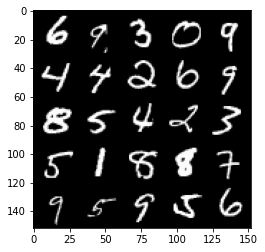

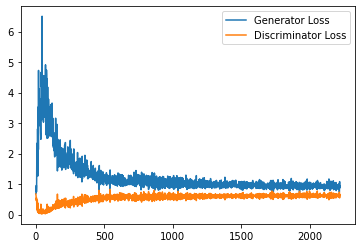

Step 45000: Generator loss: 0.9326378222703934, discriminator loss: 0.6222029874920845


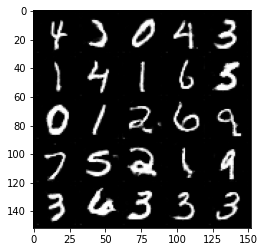

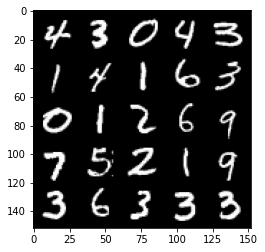

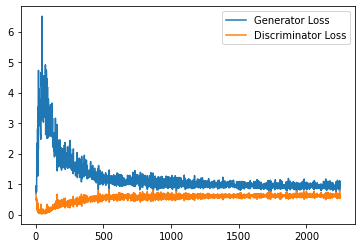

Step 45500: Generator loss: 0.9285507445335388, discriminator loss: 0.6263862324953079


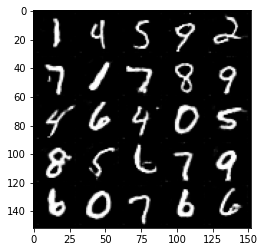

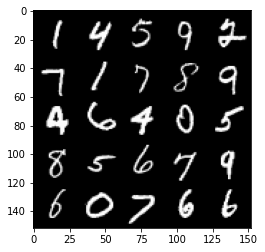

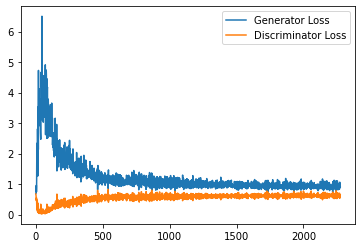

Step 46000: Generator loss: 0.9102990826368332, discriminator loss: 0.6291695532798767


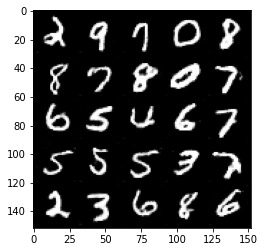

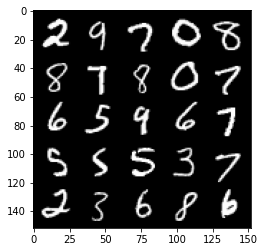

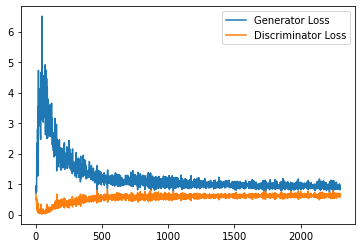

Step 46500: Generator loss: 0.9321237257719039, discriminator loss: 0.6226226121783257


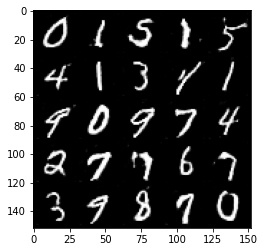

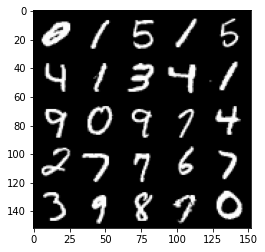

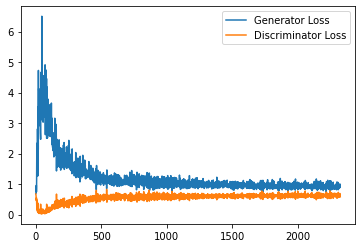

Step 47000: Generator loss: 0.9173203083276749, discriminator loss: 0.6310541220903396


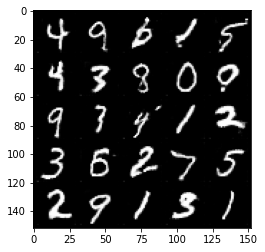

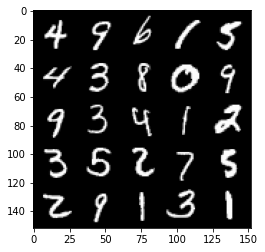

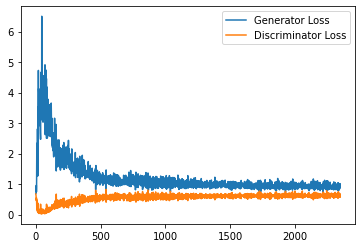

Step 47500: Generator loss: 0.9099470289945603, discriminator loss: 0.6248632932901382


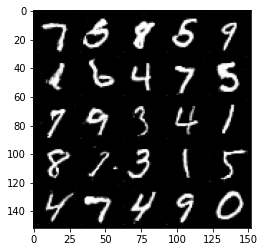

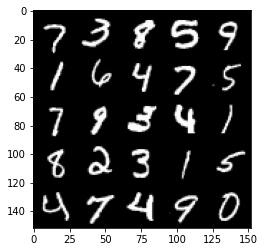

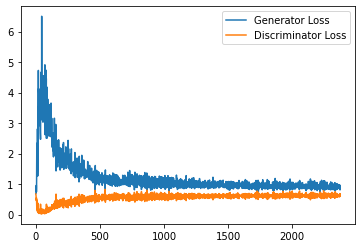

Step 48000: Generator loss: 0.9103427842855454, discriminator loss: 0.6228522934913635


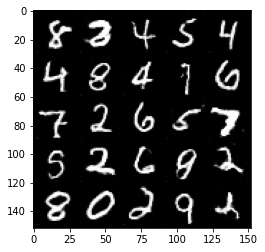

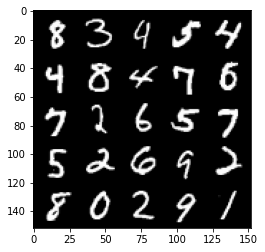

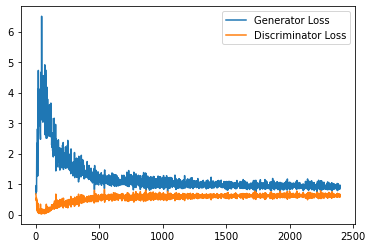

Step 48500: Generator loss: 0.9140292210578919, discriminator loss: 0.6221201708912849


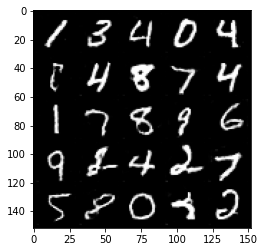

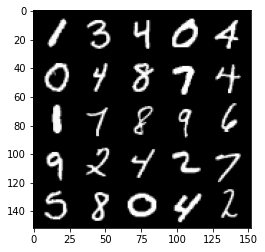

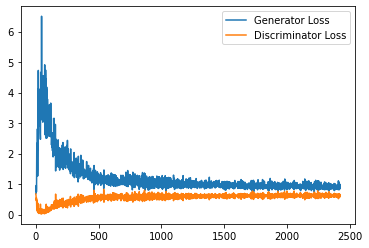

Step 49000: Generator loss: 0.8996632399559021, discriminator loss: 0.624541434764862


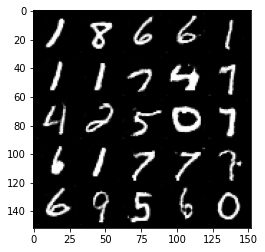

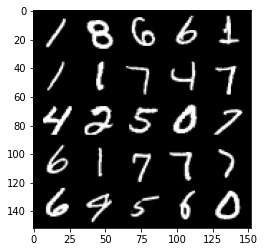

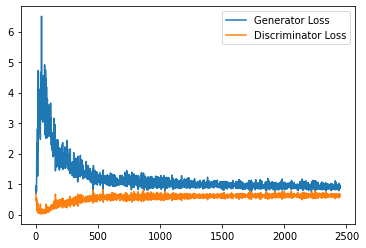

Step 49500: Generator loss: 0.9232741488218308, discriminator loss: 0.6286966066360473


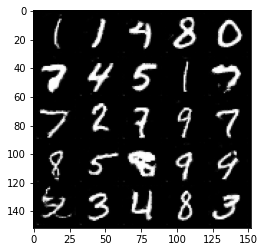

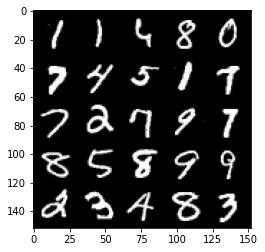

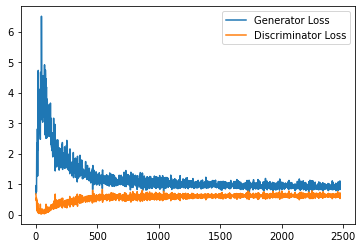

Step 50000: Generator loss: 0.9213193365335465, discriminator loss: 0.6218916726112366


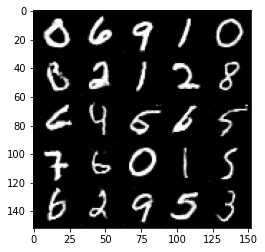

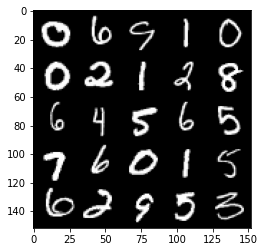

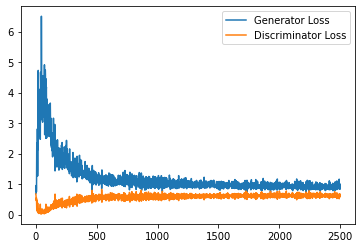

Step 50500: Generator loss: 0.9003135434389115, discriminator loss: 0.6299936076402665


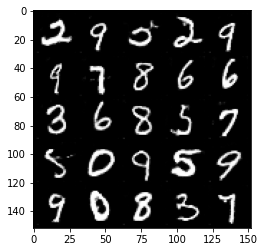

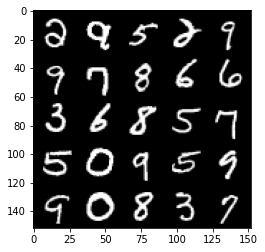

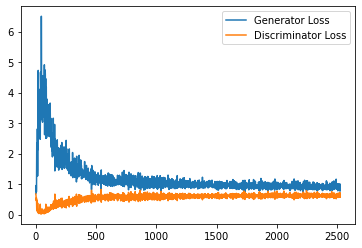

Step 51000: Generator loss: 0.9131740716695785, discriminator loss: 0.6239913310408592


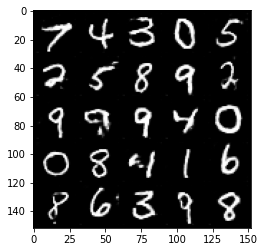

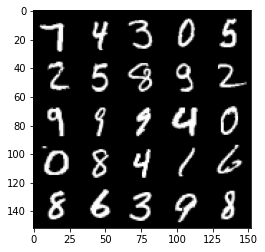

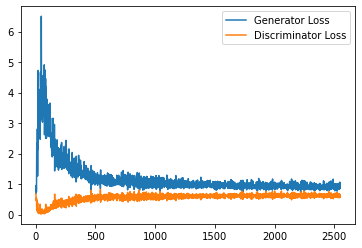

Step 51500: Generator loss: 0.902459703207016, discriminator loss: 0.6296628651022911


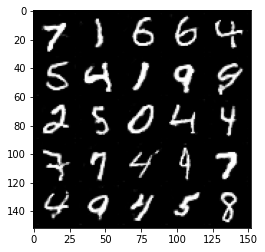

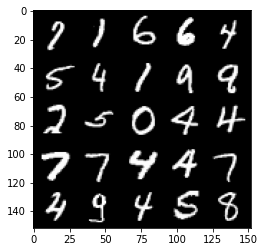

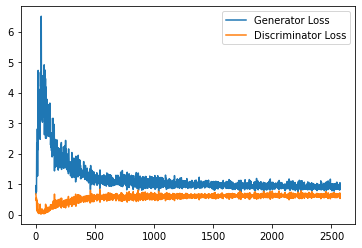

Step 52000: Generator loss: 0.9290195652246476, discriminator loss: 0.6242459133863449


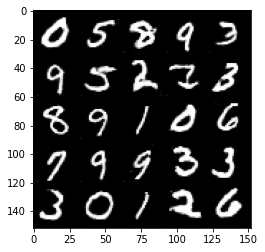

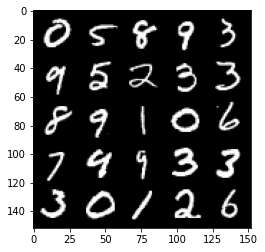

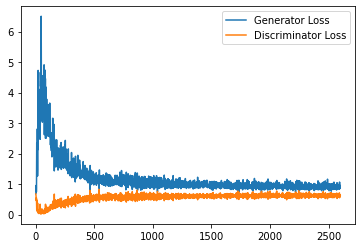

Step 52500: Generator loss: 0.9165772742033005, discriminator loss: 0.620239337682724


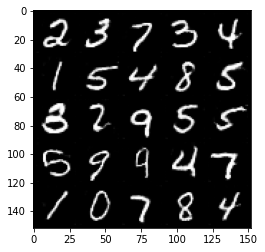

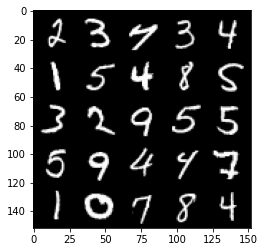

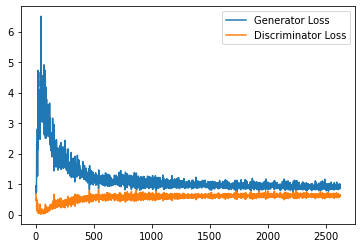

Step 53000: Generator loss: 0.9153753238916397, discriminator loss: 0.6211381089687348


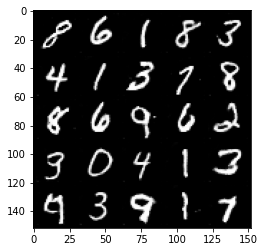

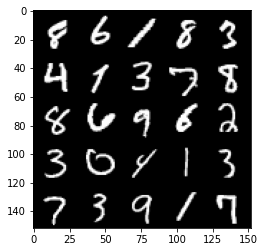

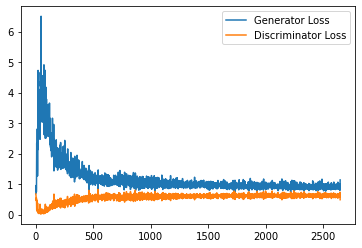

Step 53500: Generator loss: 0.9175487086772919, discriminator loss: 0.6263543292284012


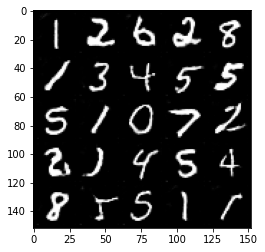

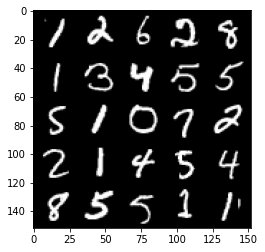

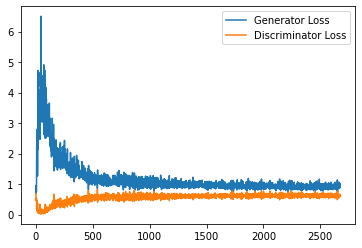

Step 54000: Generator loss: 0.9003633624315261, discriminator loss: 0.6249878815412522


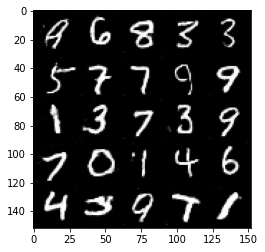

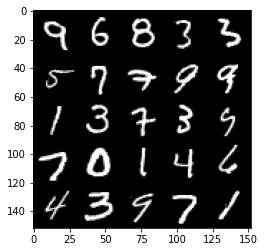

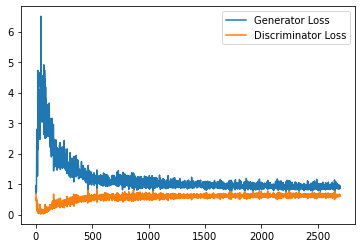

Step 54500: Generator loss: 0.9180382622480392, discriminator loss: 0.6234340059161186


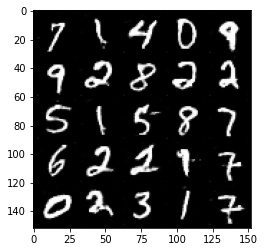

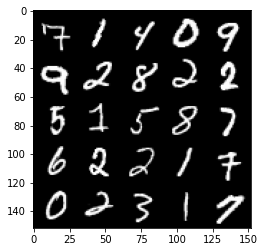

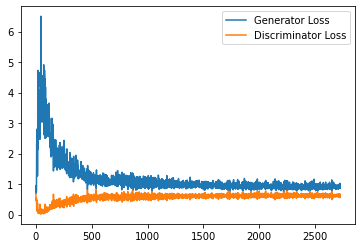

Step 55000: Generator loss: 0.9357421262264252, discriminator loss: 0.6249681447148323


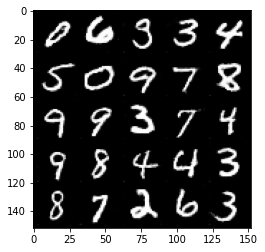

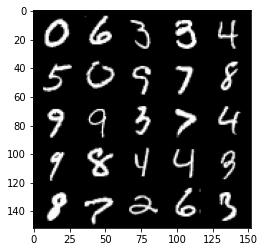

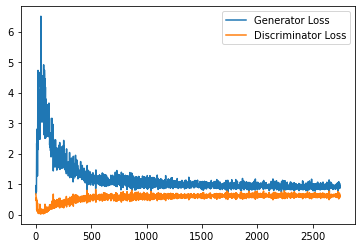

Step 55500: Generator loss: 0.9294229673147202, discriminator loss: 0.6219805196523667


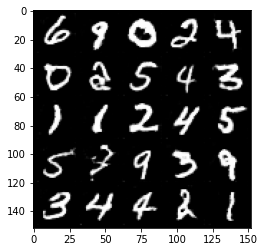

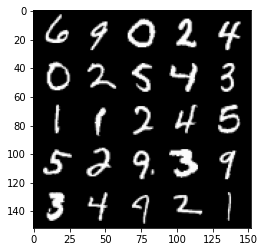

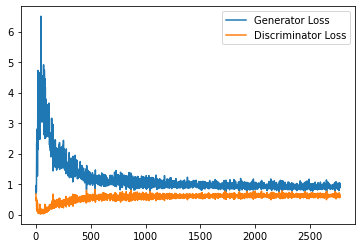

Step 56000: Generator loss: 0.8963704450130463, discriminator loss: 0.6261734453439712


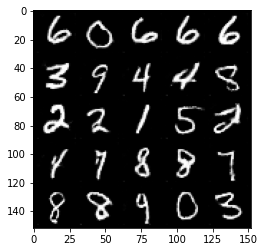

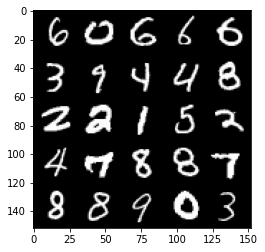

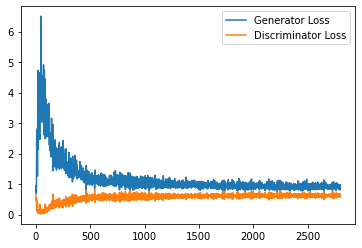

Step 56500: Generator loss: 0.9205698343515396, discriminator loss: 0.6256773259043693


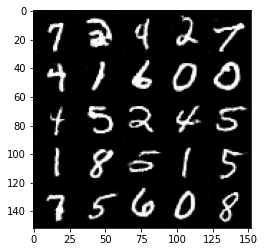

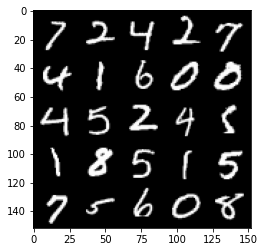

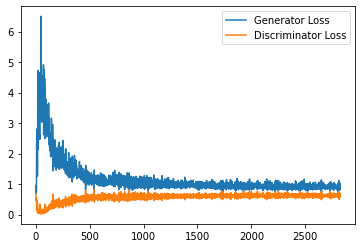

Step 57000: Generator loss: 0.9123360817432403, discriminator loss: 0.6281022045612336


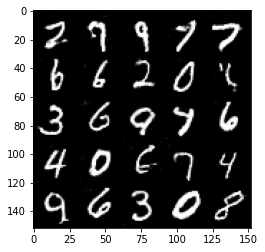

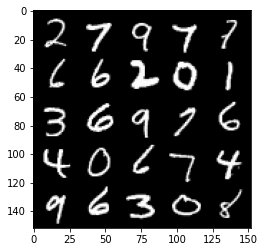

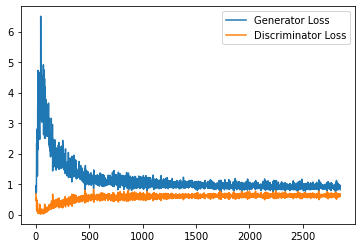

Step 57500: Generator loss: 0.9179718995094299, discriminator loss: 0.6256858984827995


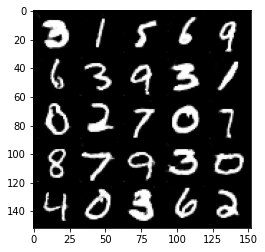

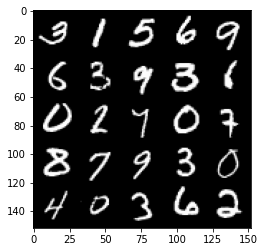

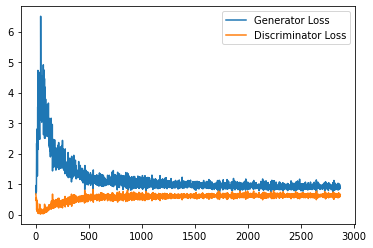

Step 58000: Generator loss: 0.9093990092277526, discriminator loss: 0.6247807837724686


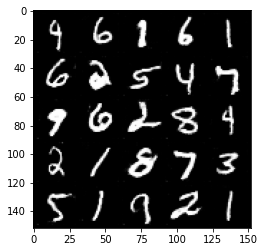

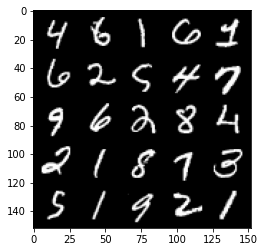

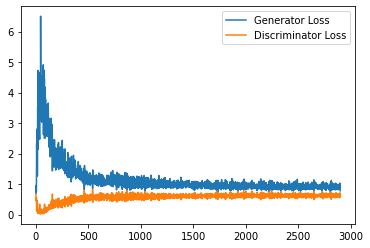

Step 58500: Generator loss: 0.9205308918952941, discriminator loss: 0.6233073116540909


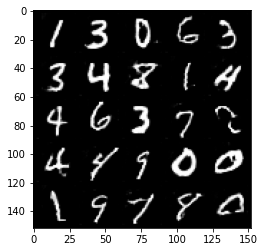

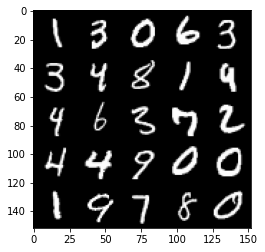

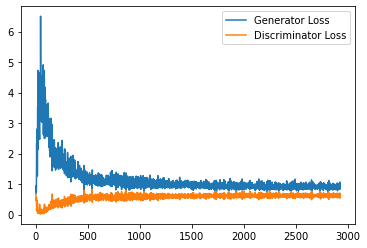

Step 59000: Generator loss: 0.9174767627716064, discriminator loss: 0.6259863588213921


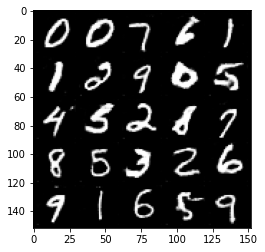

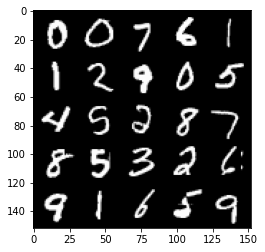

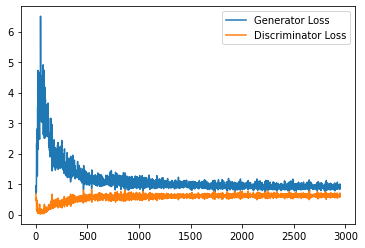

Step 59500: Generator loss: 0.9073131949901581, discriminator loss: 0.6238571074008942


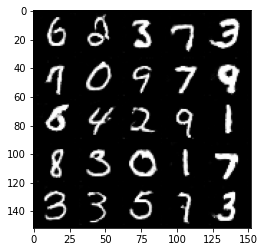

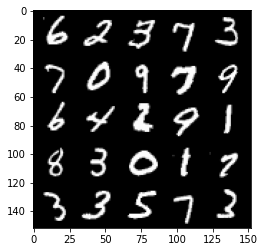

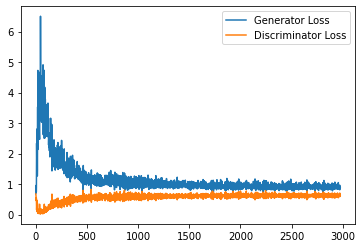

Step 60000: Generator loss: 0.9185353249311448, discriminator loss: 0.6256336935758591


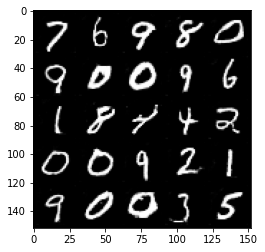

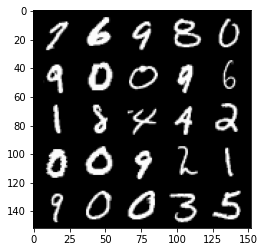

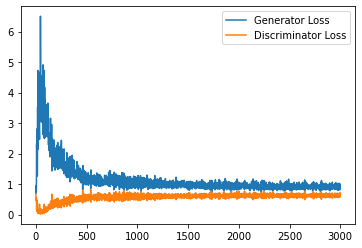

Step 60500: Generator loss: 0.9045977187156677, discriminator loss: 0.6265278183817864


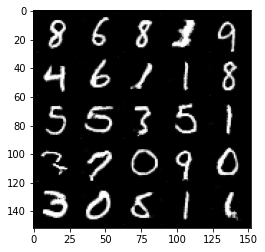

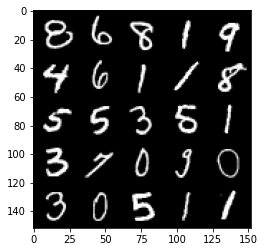

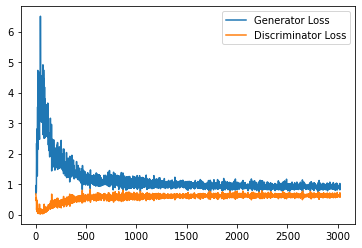

Step 61000: Generator loss: 0.9133227328062058, discriminator loss: 0.6238532521724701


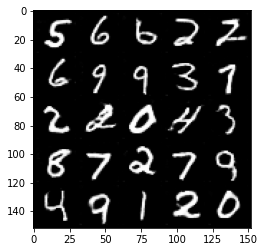

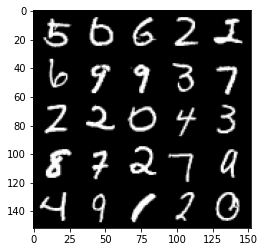

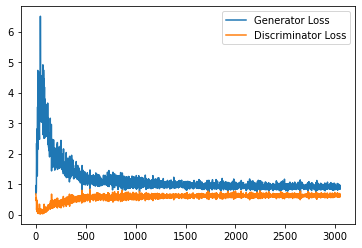

Step 61500: Generator loss: 0.9052632534503937, discriminator loss: 0.6285514876842498


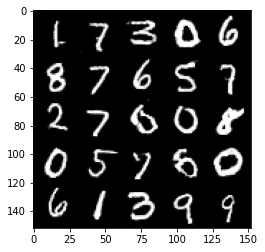

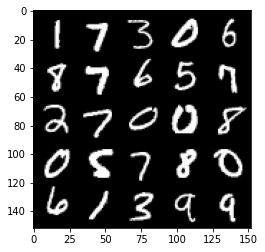

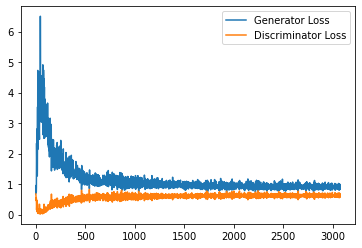

Step 62000: Generator loss: 0.9232875722646713, discriminator loss: 0.6203288428783417


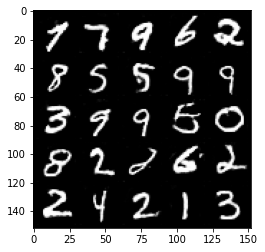

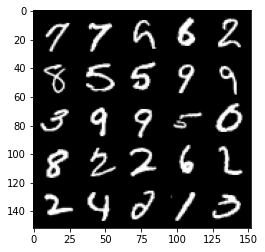

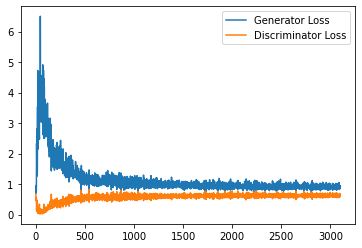

Step 62500: Generator loss: 0.9132219505310059, discriminator loss: 0.6228858590722084


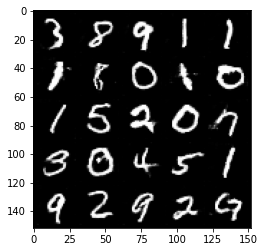

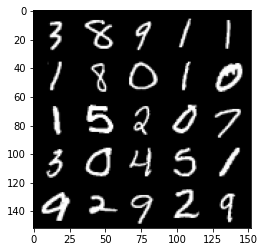

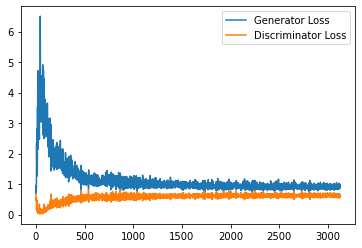

Step 63000: Generator loss: 0.9157400922775268, discriminator loss: 0.6258557621240616


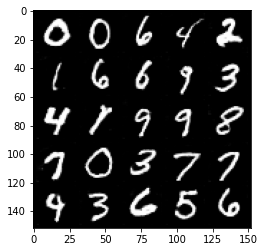

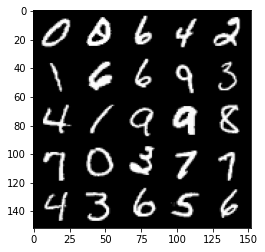

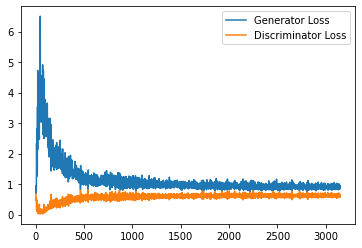

Step 63500: Generator loss: 0.9203022075891495, discriminator loss: 0.6268944938778878


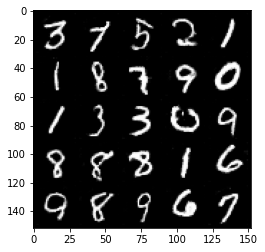

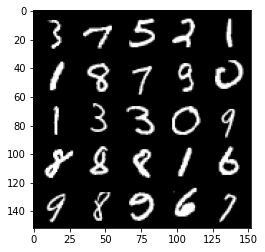

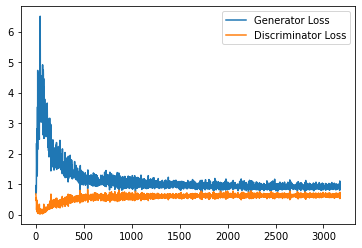

Step 64000: Generator loss: 0.9145909090042115, discriminator loss: 0.6233563294410706


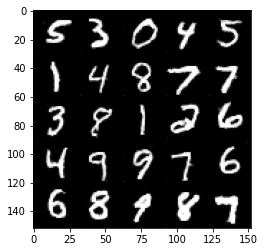

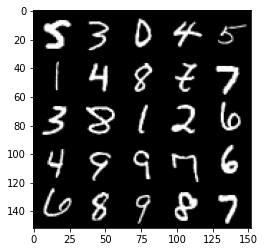

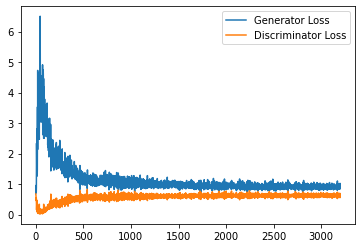

Step 64500: Generator loss: 0.906492863535881, discriminator loss: 0.6230359050631523


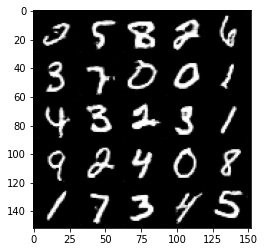

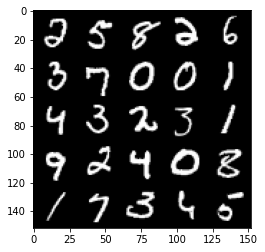

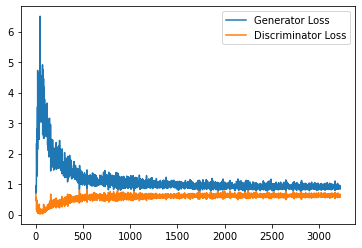

Step 65000: Generator loss: 0.912352616429329, discriminator loss: 0.6212892394661903


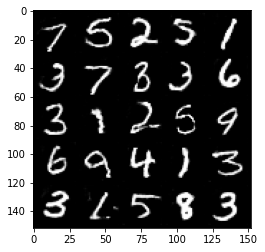

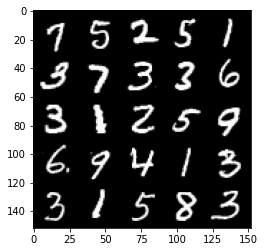

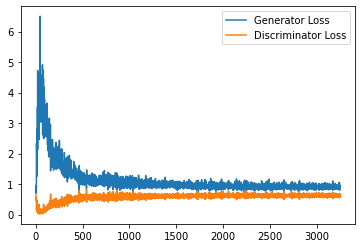

Step 65500: Generator loss: 0.9123348832130432, discriminator loss: 0.6268784640431404


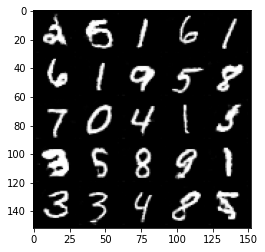

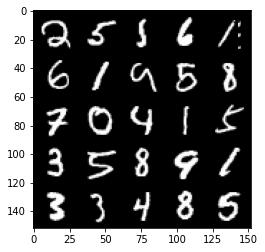

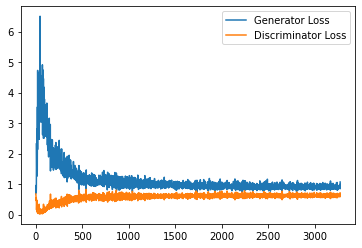

Step 66000: Generator loss: 0.9179050660133362, discriminator loss: 0.6257780884504318


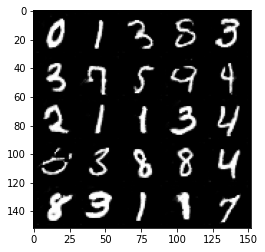

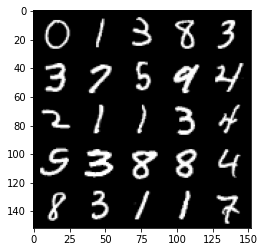

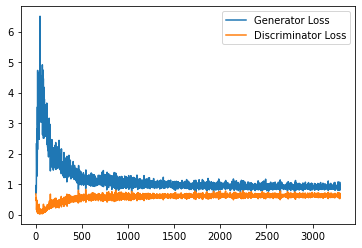

Step 66500: Generator loss: 0.9125581057071686, discriminator loss: 0.6232438237071037


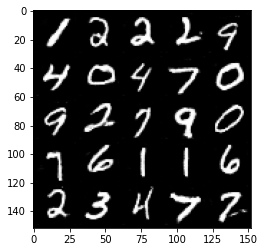

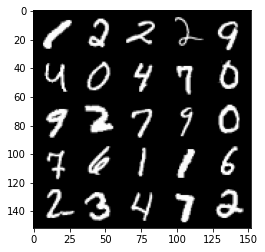

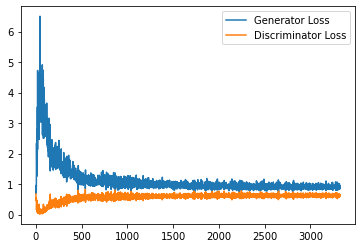

Step 67000: Generator loss: 0.9181180461645126, discriminator loss: 0.6214525055885315


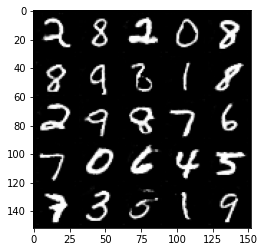

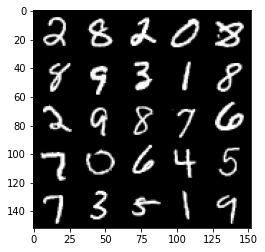

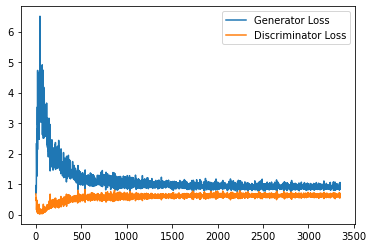

Step 67500: Generator loss: 0.9310816669464111, discriminator loss: 0.6249498772025108


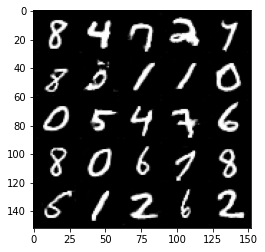

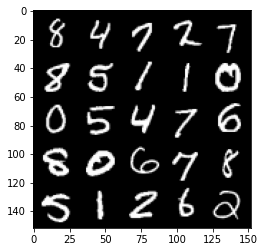

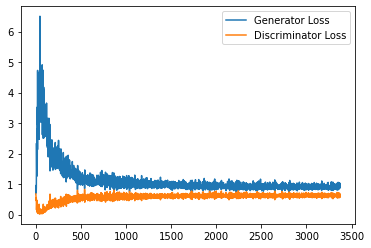

Step 68000: Generator loss: 0.9087925055027009, discriminator loss: 0.620164687871933


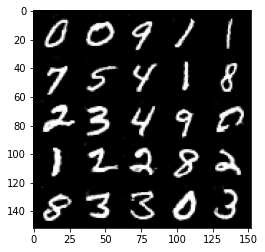

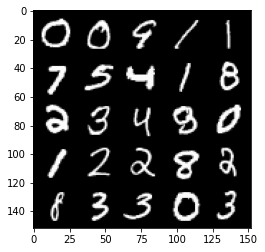

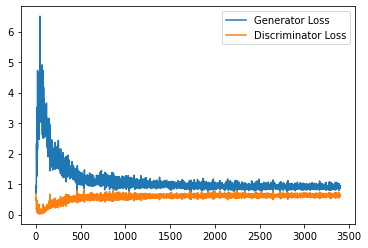

Step 68500: Generator loss: 0.907886244058609, discriminator loss: 0.6208391782045365


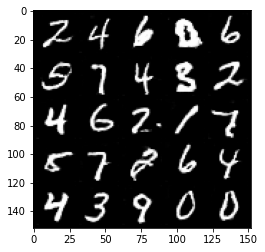

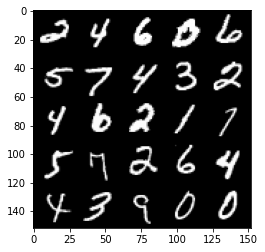

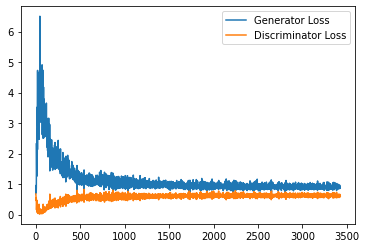

Step 69000: Generator loss: 0.9176487586498261, discriminator loss: 0.6236431479454041


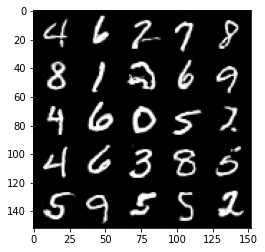

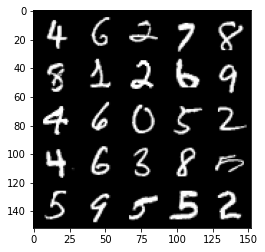

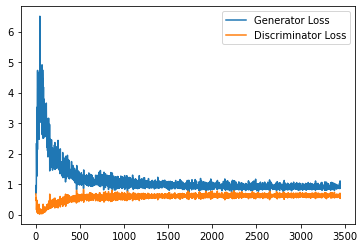

Step 69500: Generator loss: 0.925255859375, discriminator loss: 0.6229371512532235


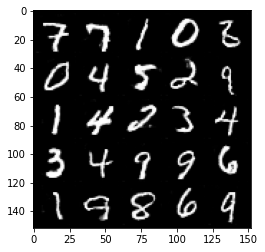

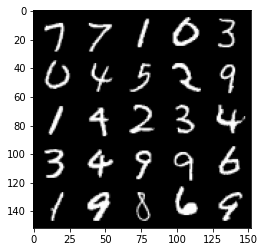

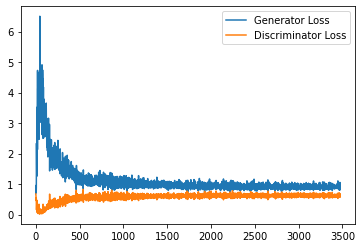

Step 70000: Generator loss: 0.9095555753707886, discriminator loss: 0.619531837940216


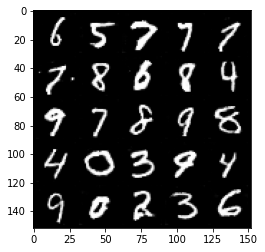

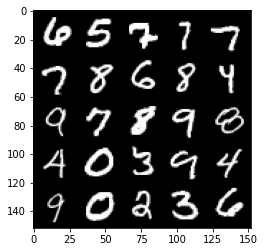

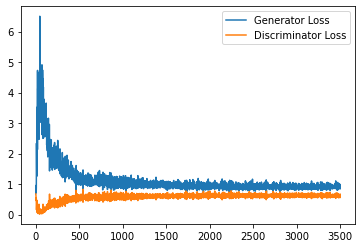

Step 70500: Generator loss: 0.9237550350427628, discriminator loss: 0.6198400661349297


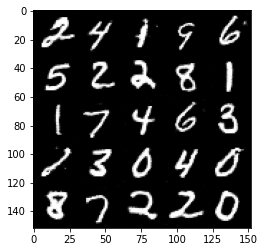

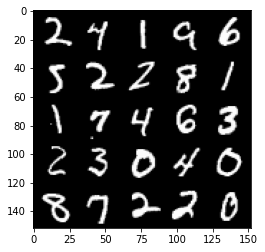

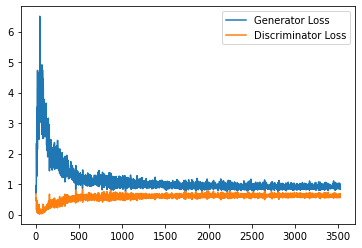

Step 71000: Generator loss: 0.9382112182378769, discriminator loss: 0.6195745988488197


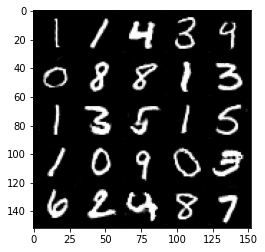

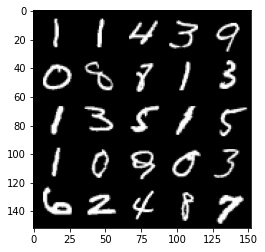

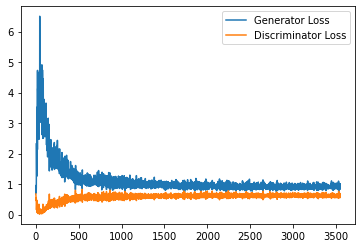

Step 71500: Generator loss: 0.9116600203514099, discriminator loss: 0.6204366049170494


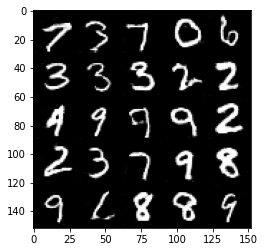

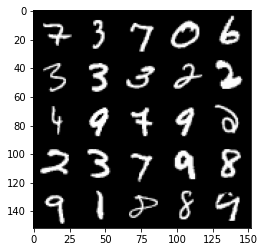

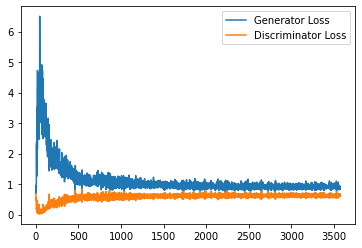

Step 72000: Generator loss: 0.9188166111707687, discriminator loss: 0.623295363008976


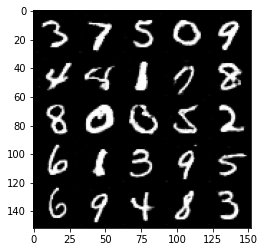

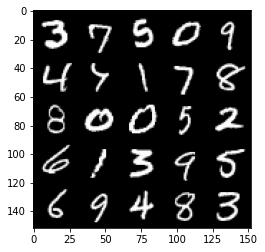

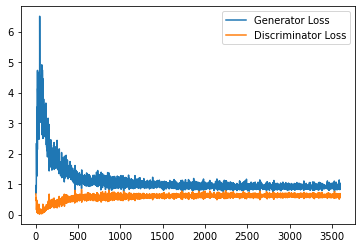

Step 72500: Generator loss: 0.9284711974859238, discriminator loss: 0.6151706696748733


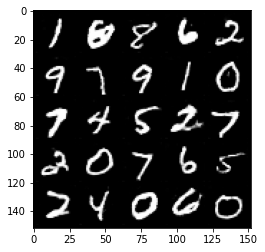

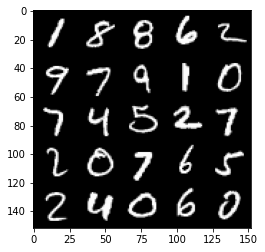

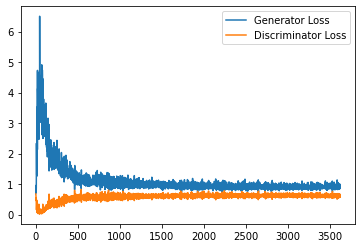

Step 73000: Generator loss: 0.9214717406034469, discriminator loss: 0.6190916825532913


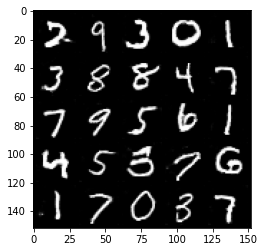

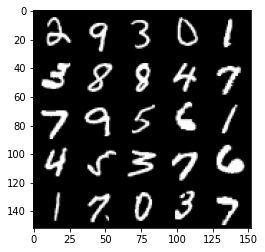

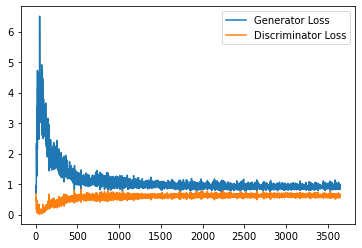

Step 73500: Generator loss: 0.9278165935277939, discriminator loss: 0.6234536188244819


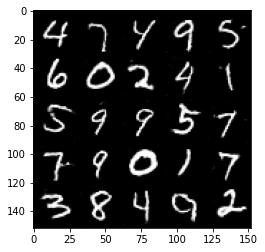

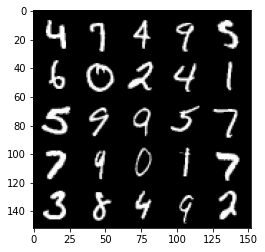

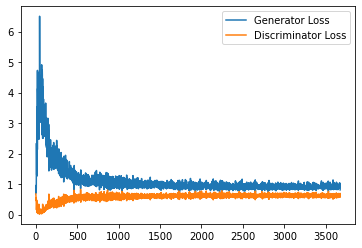

Step 74000: Generator loss: 0.9159225248098374, discriminator loss: 0.6154747899770737


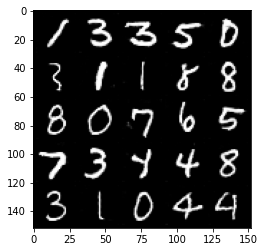

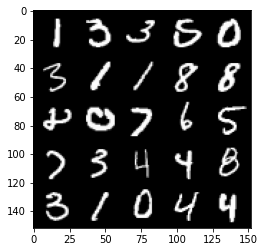

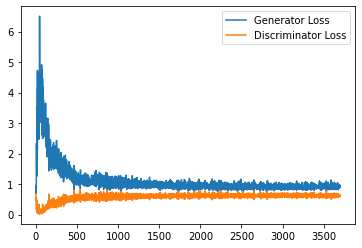

Step 74500: Generator loss: 0.9315110845565796, discriminator loss: 0.616019316136837


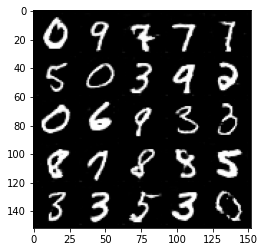

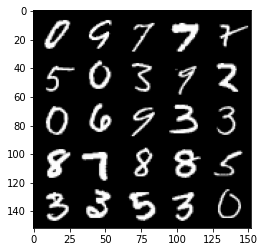

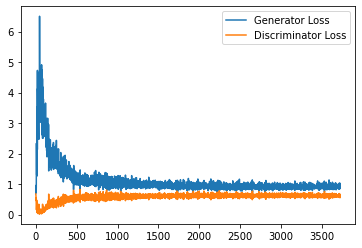

Step 75000: Generator loss: 0.9213795099258423, discriminator loss: 0.62037178504467


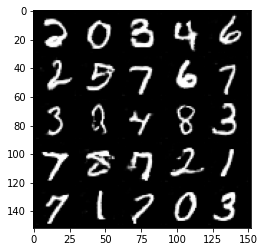

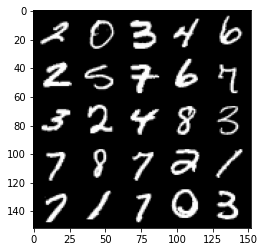

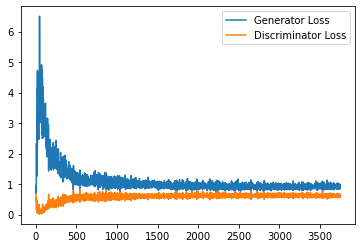

Step 75500: Generator loss: 0.9229339714050293, discriminator loss: 0.6182798119783401


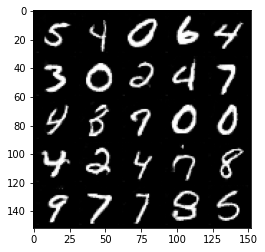

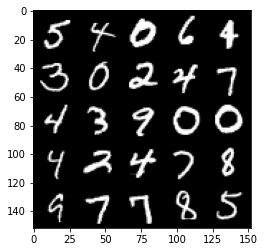

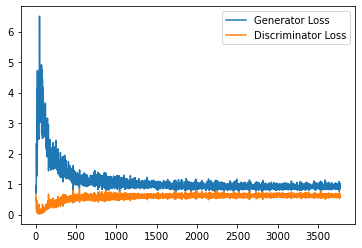

Step 76000: Generator loss: 0.9282380449771881, discriminator loss: 0.6186018929481506


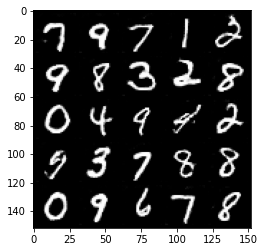

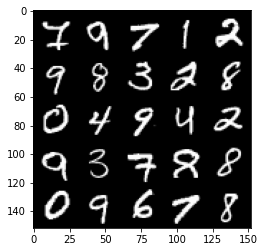

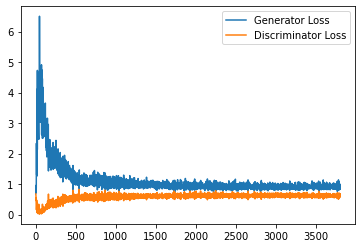

Step 76500: Generator loss: 0.9201597173213959, discriminator loss: 0.6188171721696853


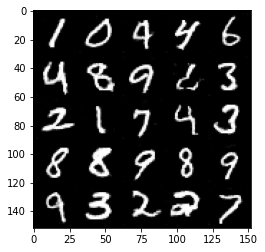

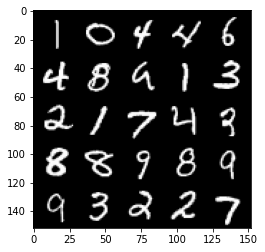

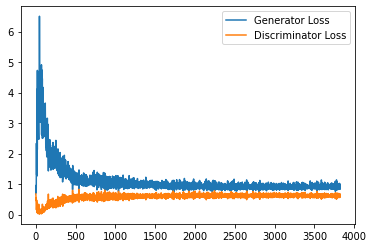

Step 77000: Generator loss: 0.9250485589504241, discriminator loss: 0.6152000007629395


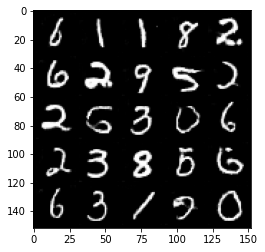

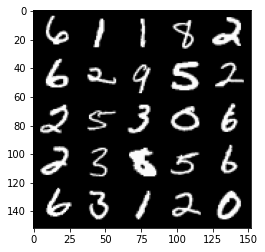

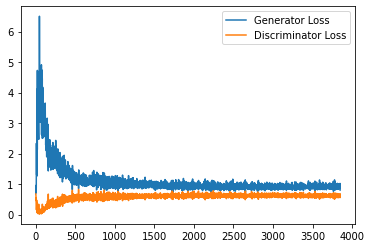

Step 77500: Generator loss: 0.9288196307420731, discriminator loss: 0.6168707193136215


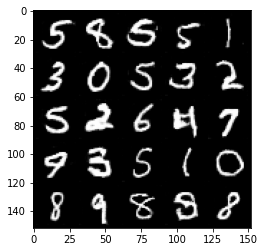

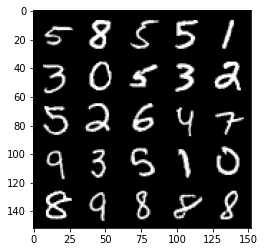

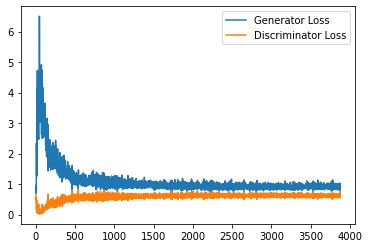

Step 78000: Generator loss: 0.9304111531972885, discriminator loss: 0.6137048826813698


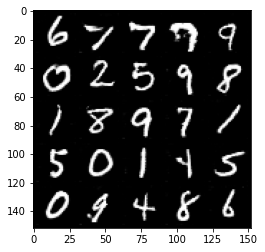

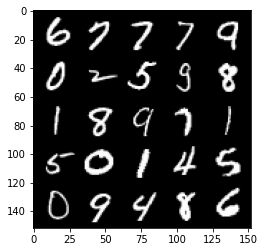

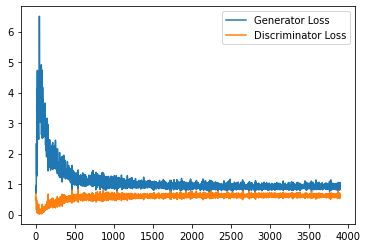

Step 78500: Generator loss: 0.9279845615625382, discriminator loss: 0.6184764658808708


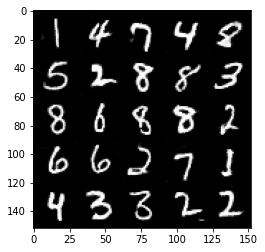

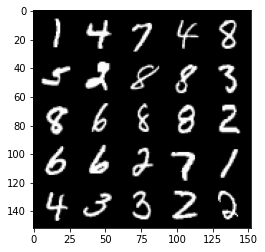

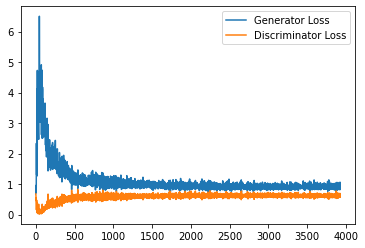

Step 79000: Generator loss: 0.9460612086057663, discriminator loss: 0.6151715328097344


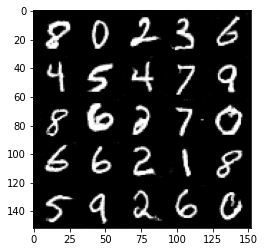

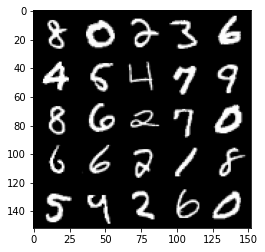

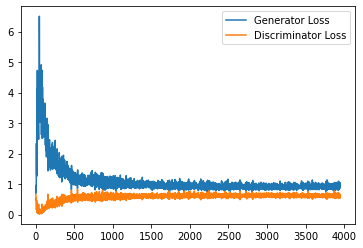

Step 79500: Generator loss: 0.9363370131254196, discriminator loss: 0.6137960696816445


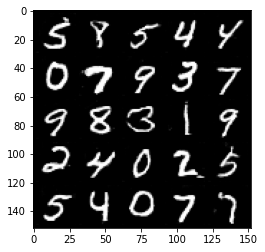

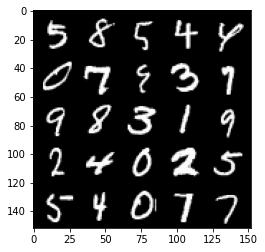

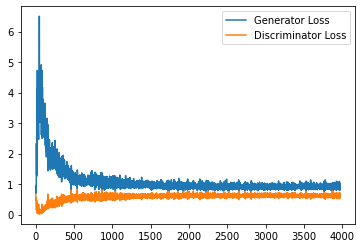

Step 80000: Generator loss: 0.9409192368984223, discriminator loss: 0.6140832456946373


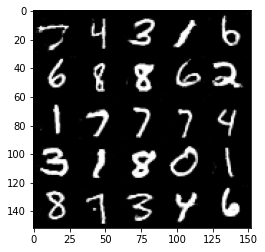

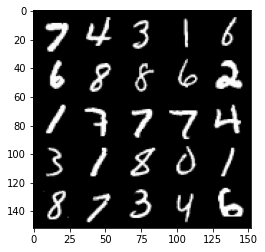

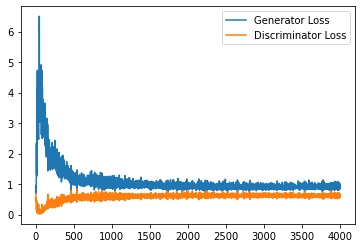

Step 80500: Generator loss: 0.9504418457746506, discriminator loss: 0.6151056291460991


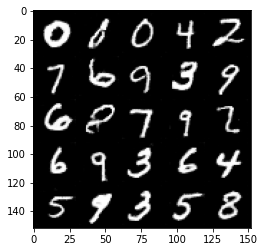

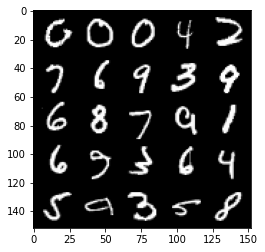

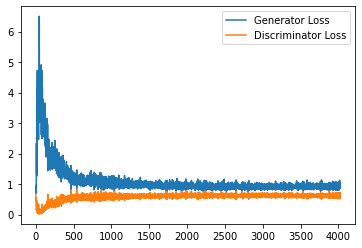

Step 81000: Generator loss: 0.9453762030601501, discriminator loss: 0.6147381125688552


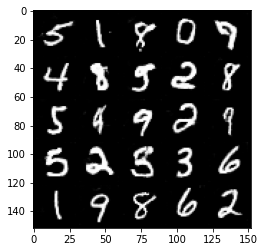

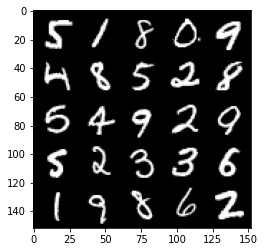

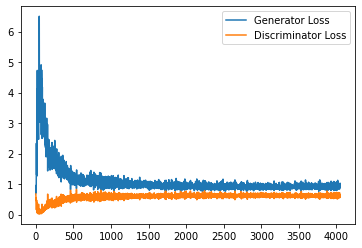

Step 81500: Generator loss: 0.9323683680295944, discriminator loss: 0.6144326198101043


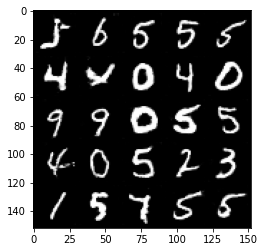

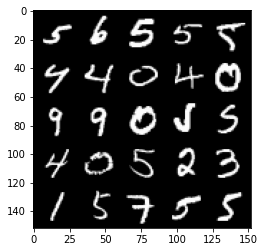

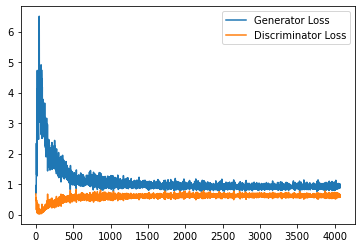

Step 82000: Generator loss: 0.9261685783863067, discriminator loss: 0.6136398444771767


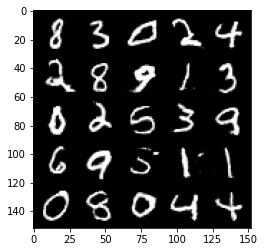

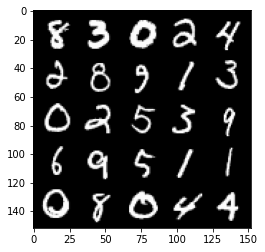

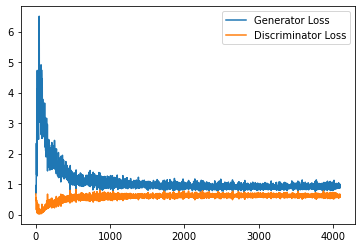

Step 82500: Generator loss: 0.9471380760669709, discriminator loss: 0.6090113967061043


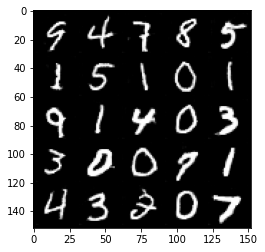

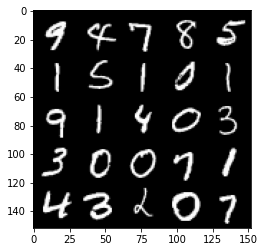

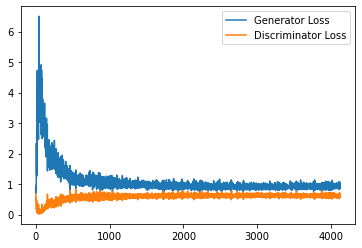

Step 83000: Generator loss: 0.9430156806707383, discriminator loss: 0.6108254317641258


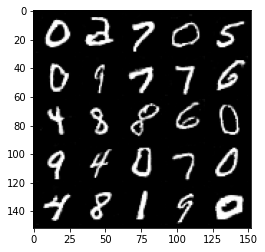

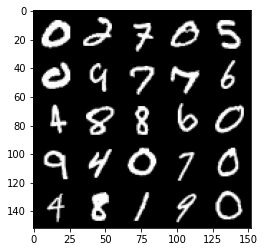

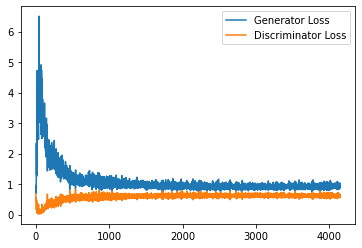

Step 83500: Generator loss: 0.9422185826301575, discriminator loss: 0.6109881646633148


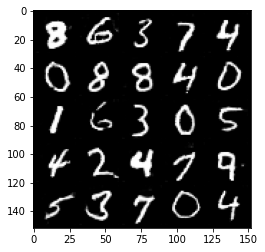

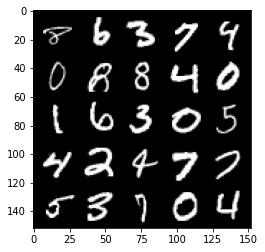

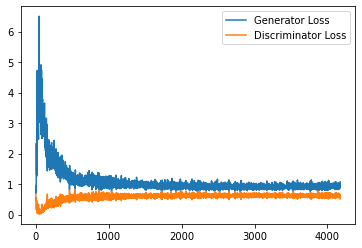

Step 84000: Generator loss: 0.9419313724040985, discriminator loss: 0.6151819068789482


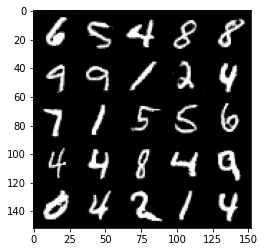

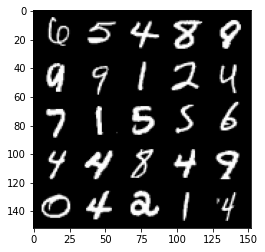

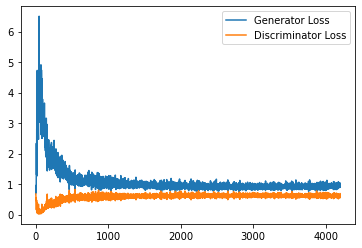

Step 84500: Generator loss: 0.9289133409261704, discriminator loss: 0.6169608117341995


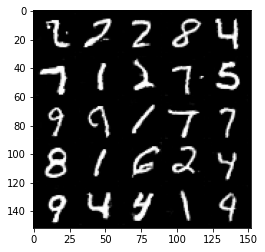

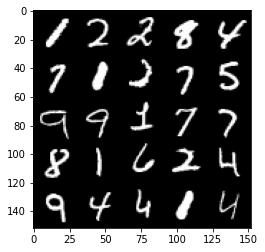

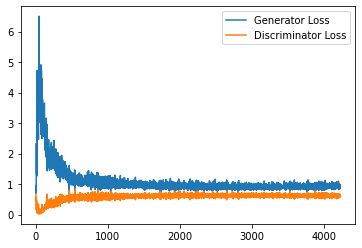

Step 85000: Generator loss: 0.934234319806099, discriminator loss: 0.6146969545483589


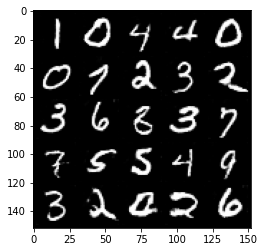

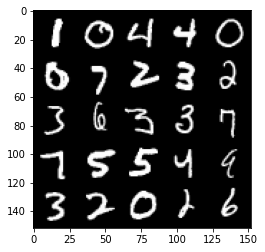

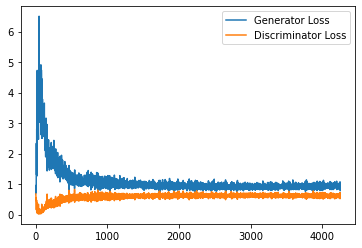

Step 85500: Generator loss: 0.9422705270051956, discriminator loss: 0.6075052760243416


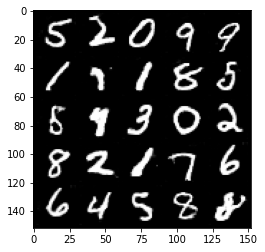

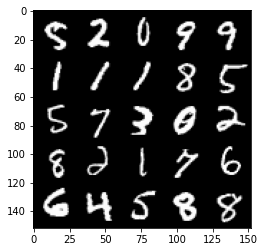

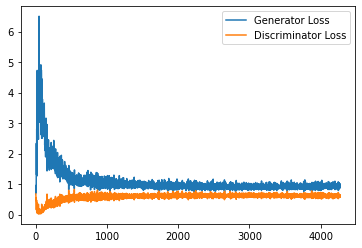

Step 86000: Generator loss: 0.947890831232071, discriminator loss: 0.6100564659237862


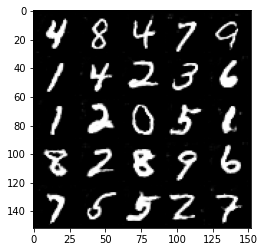

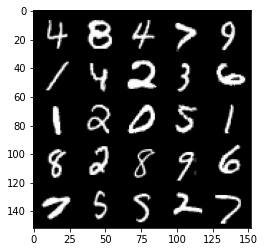

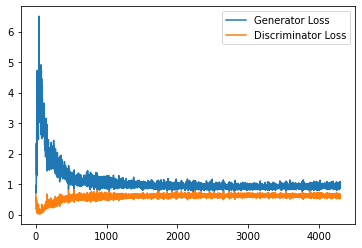

Step 86500: Generator loss: 0.9597411777973175, discriminator loss: 0.6072805755734444


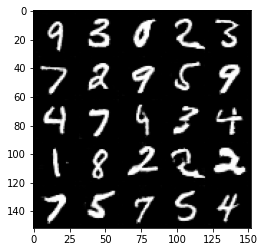

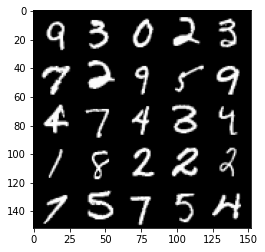

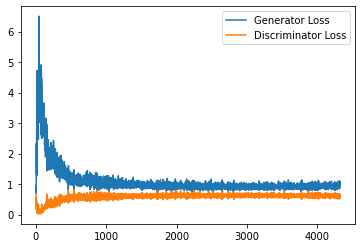

Step 87000: Generator loss: 0.9460406736135483, discriminator loss: 0.6175975559353828


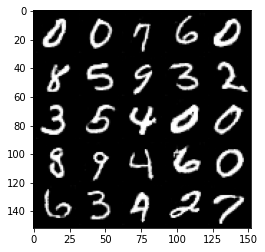

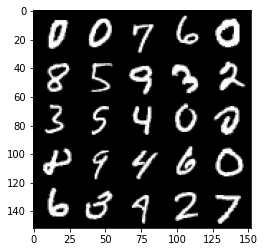

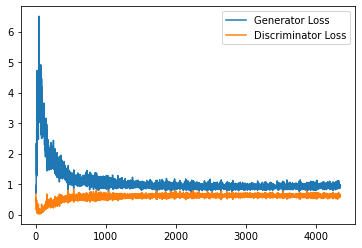

Step 87500: Generator loss: 0.9453246557712555, discriminator loss: 0.6091361011862755


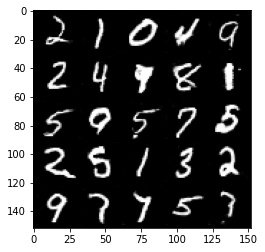

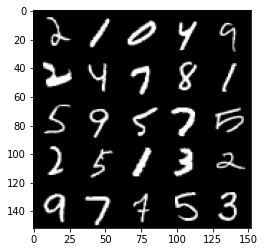

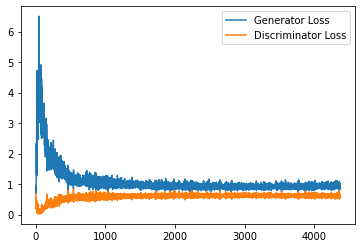

Step 88000: Generator loss: 0.9395612453222275, discriminator loss: 0.6101081691384316


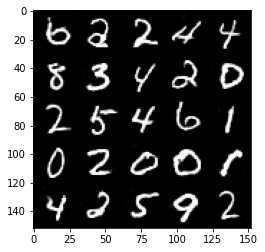

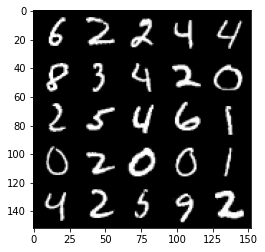

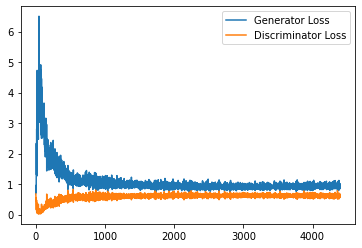

Step 88500: Generator loss: 0.9688254852294922, discriminator loss: 0.6011605425477028


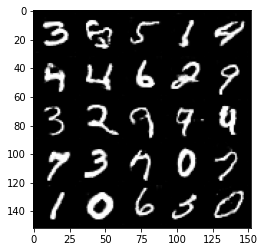

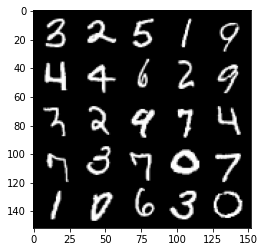

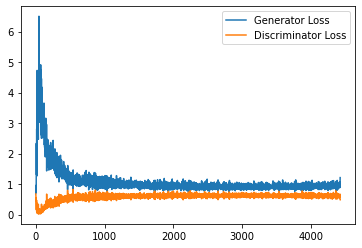

Step 89000: Generator loss: 0.9425900288820267, discriminator loss: 0.6246597902178764


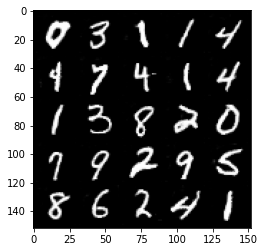

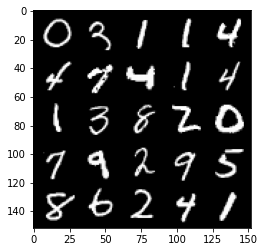

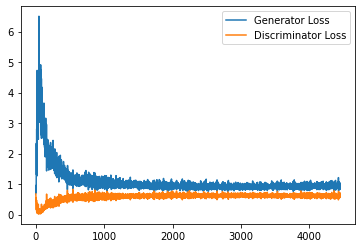

Step 89500: Generator loss: 0.9425525401830673, discriminator loss: 0.6097322152853012


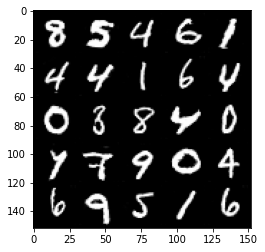

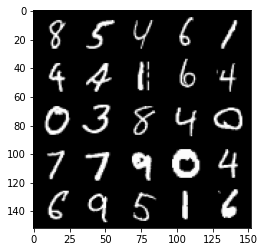

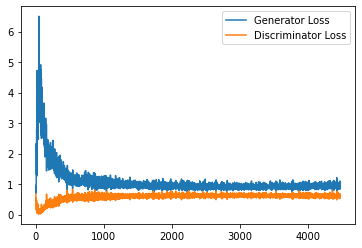

Step 90000: Generator loss: 0.9402061573266983, discriminator loss: 0.6105813341736793


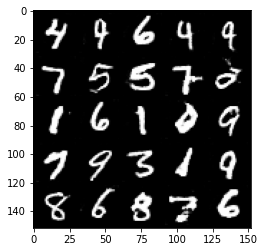

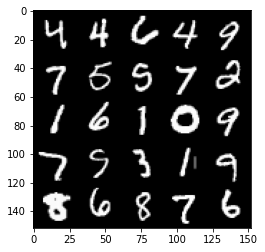

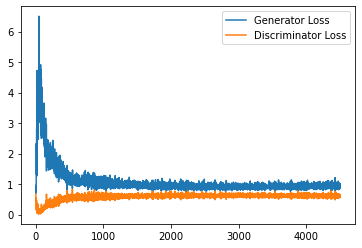

Step 90500: Generator loss: 0.9539396027326584, discriminator loss: 0.6112259632945061


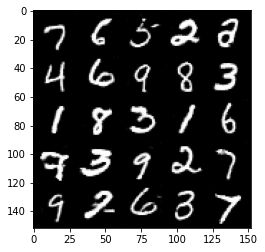

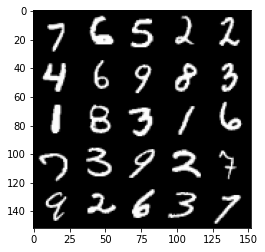

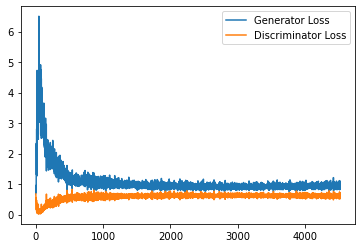

Step 91000: Generator loss: 0.944929191827774, discriminator loss: 0.6116848797798157


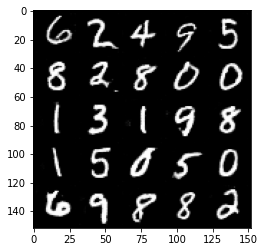

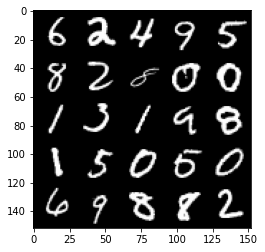

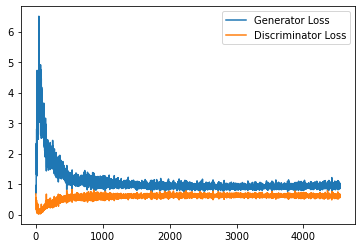

Step 91500: Generator loss: 0.9446516900062562, discriminator loss: 0.6069087764620781


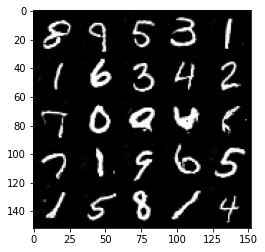

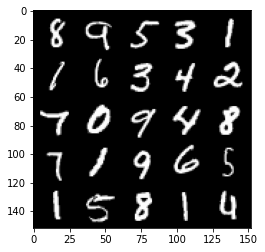

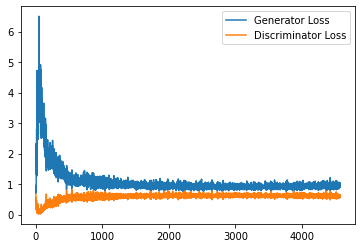

Step 92000: Generator loss: 0.9626279306411744, discriminator loss: 0.606306685090065


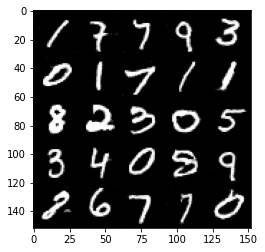

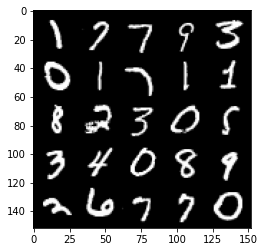

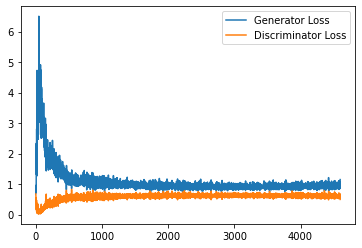

Step 92500: Generator loss: 0.9672311313152313, discriminator loss: 0.6071960382461548


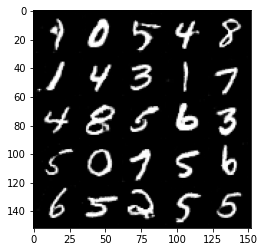

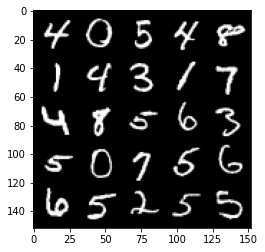

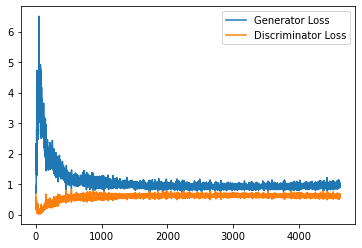

Step 93000: Generator loss: 0.9538407880067825, discriminator loss: 0.6128468655943871


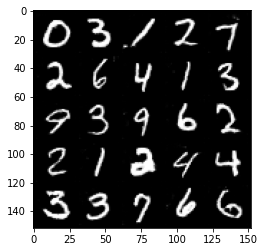

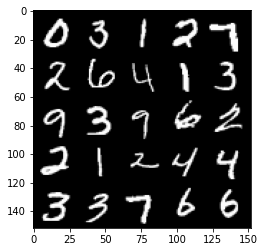

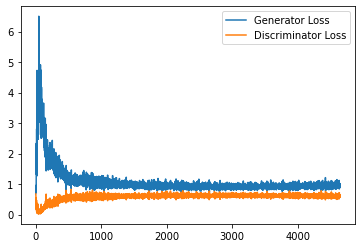

Step 93500: Generator loss: 0.9423397814035416, discriminator loss: 0.609358293056488


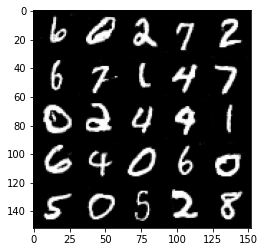

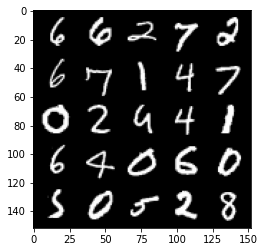

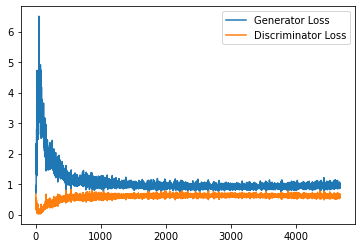

In [23]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [24]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

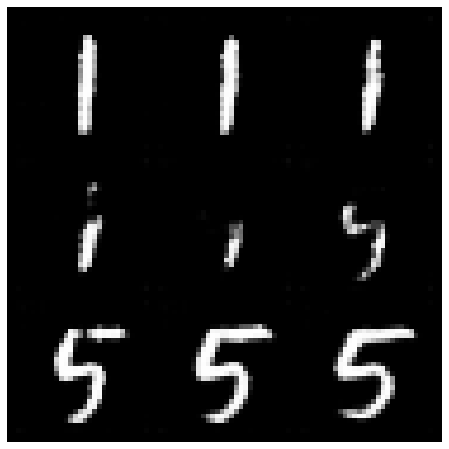

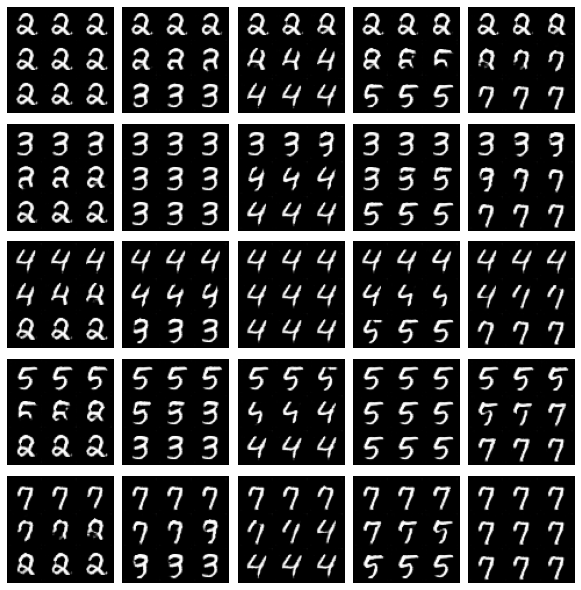

In [25]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
plot_numbers = [2, 3, 4, 5, 7]
n_numbers = len(plot_numbers)
plt.figure(figsize=(8, 8))
for i, first_plot_number in enumerate(plot_numbers):
    for j, second_plot_number in enumerate(plot_numbers):
        plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
        interpolate_class(first_plot_number, second_plot_number)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

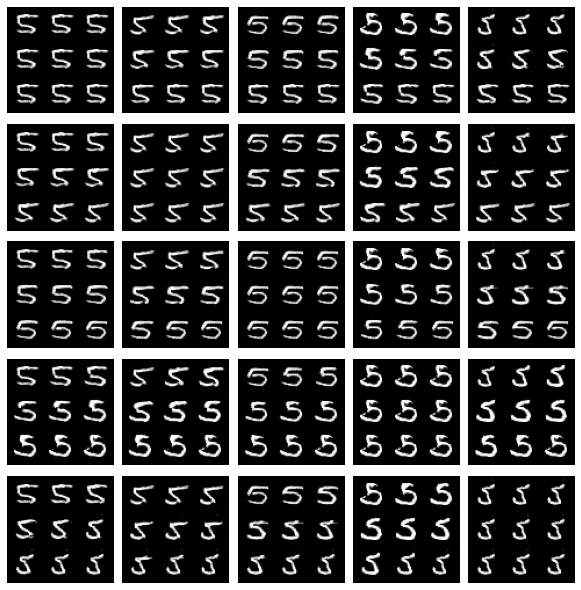

In [26]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()